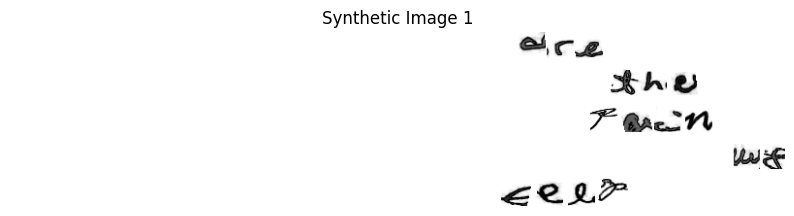

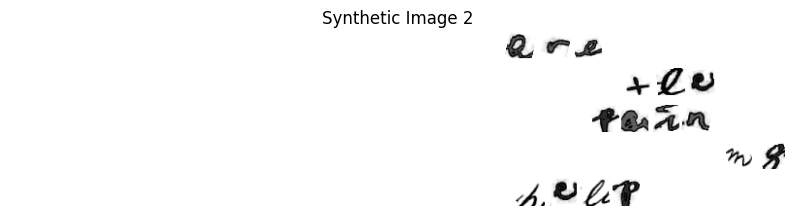

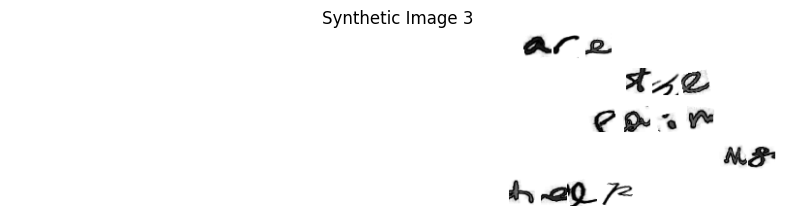

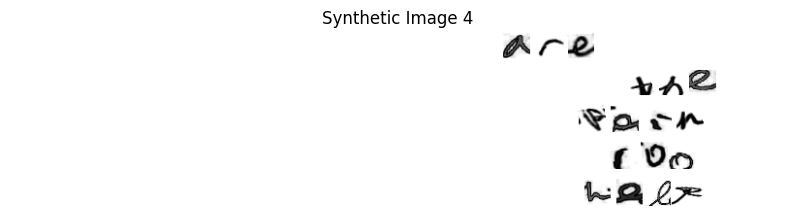

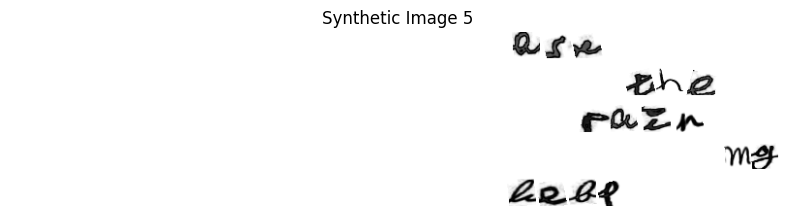

...

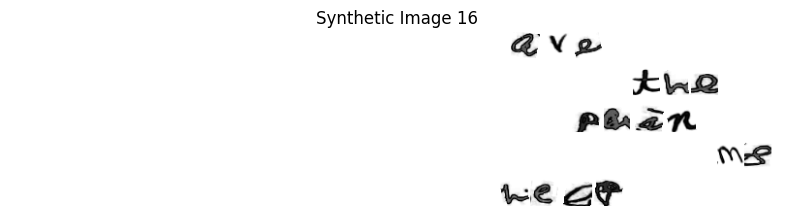

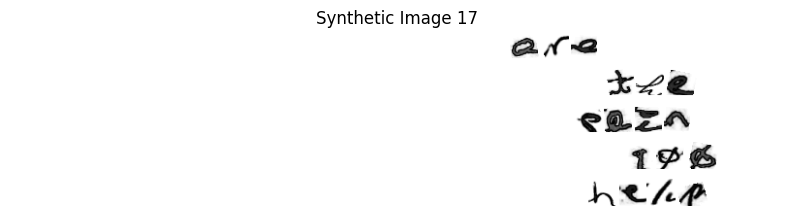

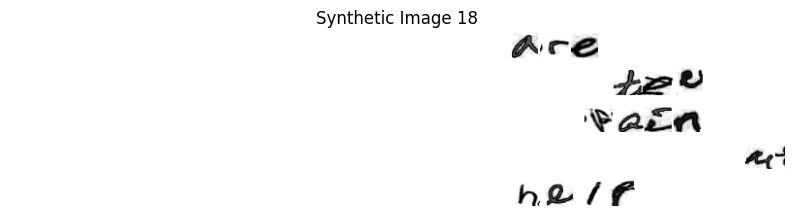

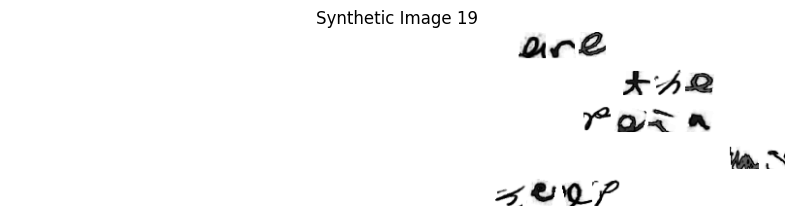

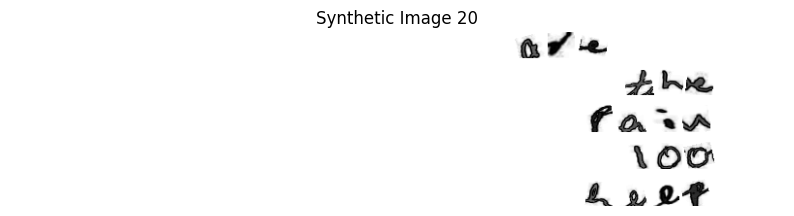

20 synthetic images have been generated and saved.


In [2]:
import os
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from scipy.ndimage import shift as scipy_shift

# Define the path to your data folder
DATA_PATH = 'data'

# Load labels from the text file
with open('label.txt', 'r') as f:
    labels = f.read().splitlines()

# Create a dictionary mapping labels to folder names
label_to_folder = {label: str(i) for i, label in enumerate(labels)}

def load_character_images():
    char_images = {}
    for label, folder in label_to_folder.items():
        folder_path = os.path.join(DATA_PATH, folder)
        images = []
        for img_file in os.listdir(folder_path):
            if img_file.endswith('.png'):
                img_path = os.path.join(folder_path, img_file)
                img = Image.open(img_path).convert('L')  # Convert to grayscale
                images.append(np.array(img))
        char_images[label] = images
    return char_images

def random_rotation(image, max_angle=15):
    angle = random.uniform(-max_angle, max_angle)
    return Image.fromarray(image).rotate(angle, resample=Image.BILINEAR, expand=True)

def random_shift(image, max_shift=2):
    shift_x = random.randint(-max_shift, max_shift)
    shift_y = random.randint(-max_shift, max_shift)
    return scipy_shift(image, (shift_y, shift_x), cval=255)

def generate_line(text, char_images, line_height=28, space_width=14):
    line_image = Image.new('L', (1, line_height), color=255)
    
    for char in text:
        if char == ' ':
            space = Image.new('L', (space_width, line_height), color=255)
            line_image = Image.new('L', (line_image.width + space.width, line_height), color=255)
            line_image.paste(space, (line_image.width - space.width, 0))
        elif char in char_images:
            char_img = random.choice(char_images[char])
            char_img = random_rotation(char_img)
            char_img = random_shift(char_img)
            char_img = Image.fromarray(char_img)
            
            new_width = line_image.width + char_img.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(char_img, (line_image.width, 0), char_img)
            line_image = new_image
    
    return line_image

def generate_multiline_image(text, char_images, max_width=800, line_spacing=10):
    words = text.split()
    lines = []
    current_line = []
    
    for word in words:
        test_line = current_line + [word]
        test_image = generate_line(' '.join(test_line), char_images)
        
        if test_image.width <= max_width:
            current_line.append(word)
        else:
            lines.append(' '.join(current_line))
            current_line = [word]
    
    if current_line:
        lines.append(' '.join(current_line))
    
    line_images = [generate_line(line, char_images) for line in lines]
    total_height = sum(img.height for img in line_images) + line_spacing * (len(line_images) - 1)
    
    multiline_image = Image.new('L', (max_width, total_height), color=255)
    y_offset = 0
    
    for line_img in line_images:
        multiline_image.paste(line_img, (0, y_offset))
        y_offset += line_img.height + line_spacing
    
    return multiline_image

# Load character images
char_images = load_character_images()

# Generate synthetic data
text = "Muscle relaxants are medications used for the treatment of muscle pain, spasm, and spasticity. 100 mg iburpofen should help"
num_images = 20

for i in range(num_images):
    image = generate_multiline_image(text, char_images)
    image.save(f'synthetic_image_{i+1}.png')
    
    plt.figure(figsize=(10, 6))
    plt.imshow(image, cmap='gray')
    plt.axis('off')
    plt.title(f'Synthetic Image {i+1}')
    plt.show()

print(f"{num_images} synthetic images have been generated and saved.")

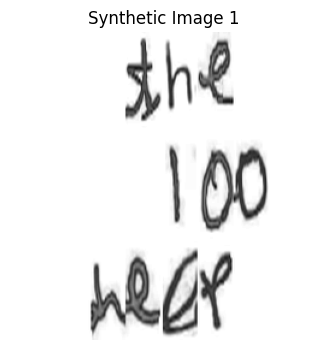

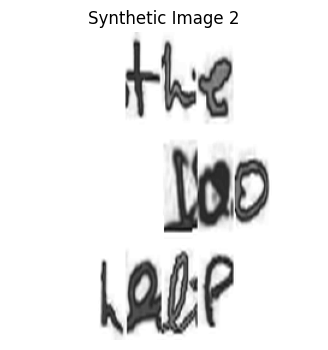

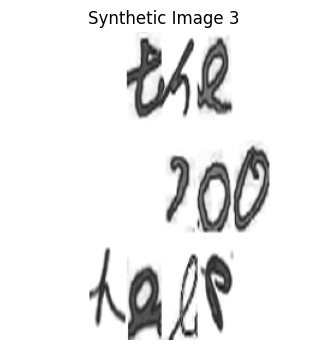

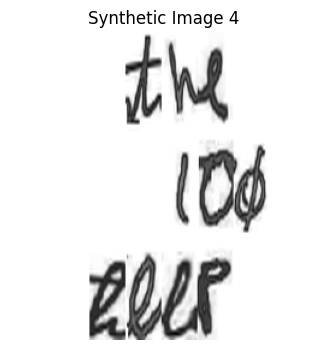

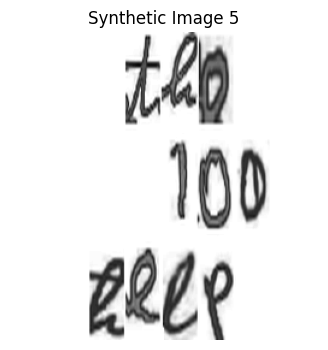

...

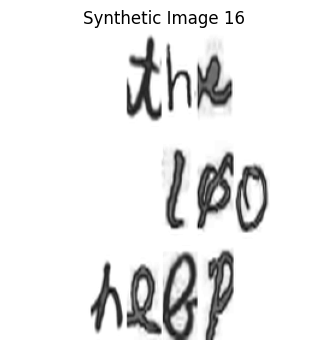

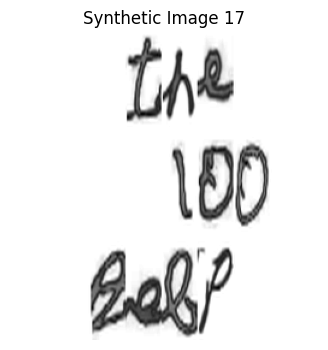

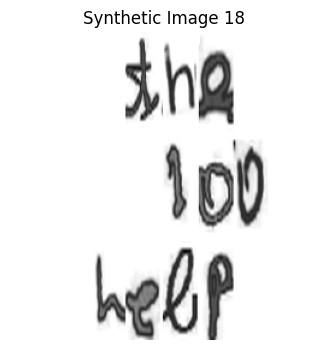

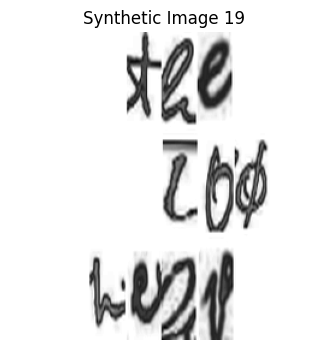

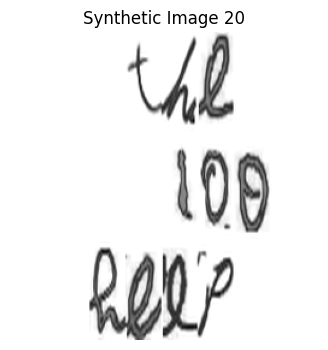

20 synthetic images have been generated and saved.


In [3]:
import os
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from scipy.ndimage import shift as scipy_shift

DATA_PATH = 'data'

with open('label.txt', 'r') as f:
    labels = f.read().splitlines()

label_to_folder = {label: str(i) for i, label in enumerate(labels)}

def load_character_images():
    char_images = {}
    for label, folder in label_to_folder.items():
        folder_path = os.path.join(DATA_PATH, folder)
        images = []
        for img_file in os.listdir(folder_path):
            if img_file.endswith('.png'):
                img_path = os.path.join(folder_path, img_file)
                img = Image.open(img_path).convert('L')  # Convert to grayscale
                images.append(np.array(img))
        char_images[label] = images
    return char_images

def random_rotation(image, max_angle=5):
    angle = random.uniform(-max_angle, max_angle)
    return Image.fromarray(image).rotate(angle, resample=Image.BILINEAR, expand=False)

def random_shift(image, max_shift=1):
    shift_x = random.randint(-max_shift, max_shift)
    shift_y = random.randint(-max_shift, max_shift)
    return scipy_shift(image, (shift_y, shift_x), cval=255)

def generate_line(text, char_images, line_height=28, space_width=5):
    line_image = Image.new('L', (1, line_height), color=255)
    
    for char in text:
        if char == ' ':
            space = Image.new('L', (space_width, line_height), color=255)
            line_image = Image.new('L', (line_image.width + space.width, line_height), color=255)
            line_image.paste(space, (line_image.width - space.width, 0))
        elif char in char_images:
            char_img = random.choice(char_images[char])
            char_img = random_rotation(char_img)
            char_img = random_shift(char_img)
            char_img = Image.fromarray(char_img)
            
            new_width = line_image.width + char_img.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(char_img, (line_image.width, 0), char_img)
            line_image = new_image
    
    return line_image

def generate_multiline_image(text, char_images, max_width=240, line_spacing=5):
    words = text.split()
    lines = []
    current_line = []
    
    for word in words:
        test_line = current_line + [word]
        test_image = generate_line(' '.join(test_line), char_images)
        
        if test_image.width <= max_width:
            current_line.append(word)
        else:
            lines.append(' '.join(current_line))
            current_line = [word]
    
    if current_line:
        lines.append(' '.join(current_line))
    
    line_images = [generate_line(line, char_images) for line in lines]
    total_height = sum(img.height for img in line_images) + line_spacing * (len(line_images) - 1)
    
    multiline_image = Image.new('L', (max_width, total_height), color=255)
    y_offset = 0
    
    for line_img in line_images:
        multiline_image.paste(line_img, (0, y_offset))
        y_offset += line_img.height + line_spacing
    
    # Resize to 256x256
    multiline_image = multiline_image.resize((256, 256), Image.LANCZOS)
    return multiline_image

# Load character images
char_images = load_character_images()

# Generate synthetic data
text = "all the pain 100 mg help"
num_images = 20

for i in range(num_images):
    image = generate_multiline_image(text, char_images)
    image.save(f'synthetic_image_{i+1}.png')
    
    plt.figure(figsize=(4, 4))
    plt.imshow(image, cmap='gray')
    plt.axis('off')
    plt.title(f'Synthetic Image {i+1}')
    plt.show()

print(f"{num_images} synthetic images have been generated and saved.")

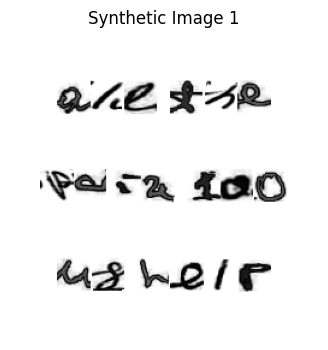

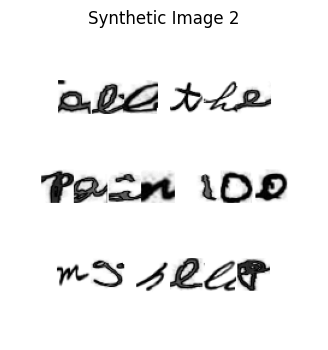

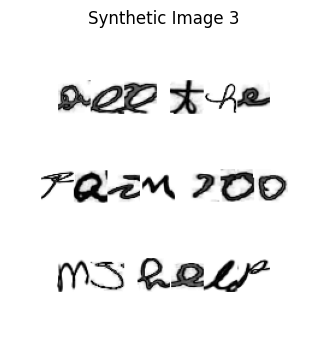

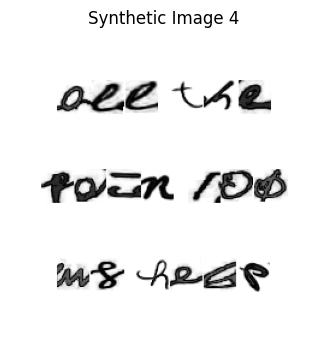

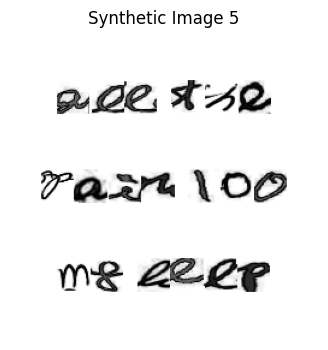

...

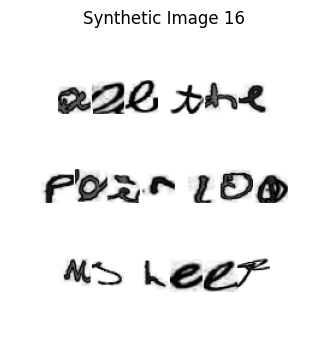

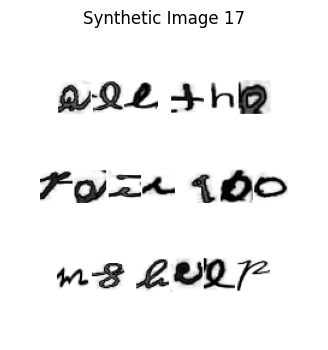

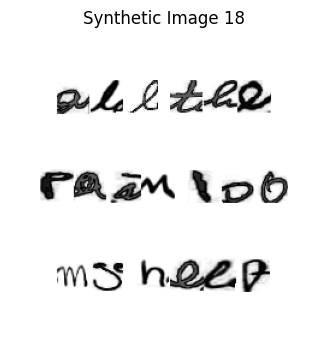

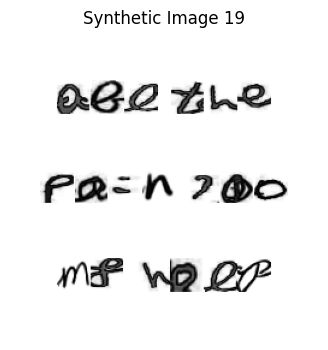

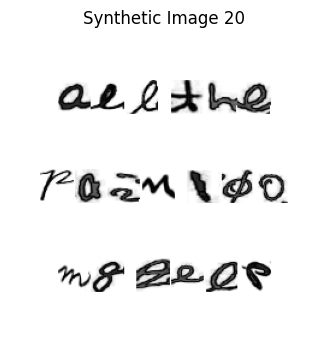

20 synthetic images have been generated and saved.


In [5]:
import os
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from scipy.ndimage import shift as scipy_shift

DATA_PATH = 'data'

with open('label.txt', 'r') as f:
    labels = f.read().splitlines()

label_to_folder = {label: str(i) for i, label in enumerate(labels)}

def load_character_images():
    char_images = {}
    for label, folder in label_to_folder.items():
        folder_path = os.path.join(DATA_PATH, folder)
        images = []
        for img_file in os.listdir(folder_path):
            if img_file.endswith('.png'):
                img_path = os.path.join(folder_path, img_file)
                img = Image.open(img_path).convert('L')  # Convert to grayscale
                images.append(np.array(img))
        char_images[label] = images
    return char_images

def random_rotation(image, max_angle=5):
    angle = random.uniform(-max_angle, max_angle)
    return Image.fromarray(image).rotate(angle, resample=Image.BILINEAR, expand=False)

def random_shift(image, max_shift=1):
    shift_x = random.randint(-max_shift, max_shift)
    shift_y = random.randint(-max_shift, max_shift)
    return scipy_shift(image, (shift_y, shift_x), cval=255)

def scale_image(image, max_size=64):
    h, w = image.shape
    scale = min(max_size / max(h, w), 1)
    new_h, new_w = int(h * scale), int(w * scale)
    return Image.fromarray(image).resize((new_w, new_h), Image.LANCZOS)

def generate_line(text, char_images, line_height=64, space_width=10):
    line_image = Image.new('L', (1, line_height), color=255)
    
    for char in text:
        if char == ' ':
            space = Image.new('L', (space_width, line_height), color=255)
            new_width = line_image.width + space.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(space, (line_image.width, 0))
            line_image = new_image
        elif char in char_images:
            char_img = random.choice(char_images[char])
            char_img = scale_image(char_img)
            char_img = random_rotation(np.array(char_img))
            char_img = random_shift(char_img)
            char_img = Image.fromarray(char_img)
            
            new_width = line_image.width + char_img.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(char_img, (line_image.width, (line_height - char_img.height) // 2), char_img)
            line_image = new_image
        else:
            print(f"Character '{char}' not found in char_images")
    
    return line_image


def generate_multiline_image(text, char_images, max_width=256, line_spacing=10):
    words = text.split()
    lines = []
    current_line = []
    
    for word in words:
        test_line = current_line + [word]
        test_image = generate_line(' '.join(test_line), char_images)
        
        if test_image.width <= max_width:
            current_line.append(word)
        else:
            if current_line:
                lines.append(' '.join(current_line))
                current_line = [word]
            else:
                lines.append(word)
                current_line = []
    
    if current_line:
        lines.append(' '.join(current_line))
    
    line_images = [generate_line(line, char_images) for line in lines]
    total_height = sum(img.height for img in line_images) + line_spacing * (len(line_images) - 1)
    
    multiline_image = Image.new('L', (max_width, total_height), color=255)
    y_offset = 0
    
    for line_img in line_images:
        multiline_image.paste(line_img, ((max_width - line_img.width) // 2, y_offset))
        y_offset += line_img.height + line_spacing
    
    # Resize to 256x256, maintaining aspect ratio and adding padding if necessary
    aspect_ratio = multiline_image.width / multiline_image.height
    if aspect_ratio > 1:
        new_width = 256
        new_height = int(256 / aspect_ratio)
    else:
        new_height = 256
        new_width = int(256 * aspect_ratio)
    
    resized_image = multiline_image.resize((new_width, new_height), Image.LANCZOS)
    final_image = Image.new('L', (256, 256), color=255)
    final_image.paste(resized_image, ((256 - new_width) // 2, (256 - new_height) // 2))
    
    return final_image

# Load character images
char_images = load_character_images()

# Generate synthetic data
text = "all the pain 100 mg help"
num_images = 20

for i in range(num_images):
    image = generate_multiline_image(text, char_images)
    image.save(f'synthetic_image_{i+1}.png')
    
    plt.figure(figsize=(4, 4))
    plt.imshow(image, cmap='gray')
    plt.axis('off')
    plt.title(f'Synthetic Image {i+1}')
    plt.show()

print(f"{num_images} synthetic images have been generated and saved.")

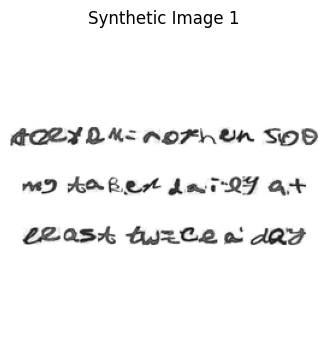

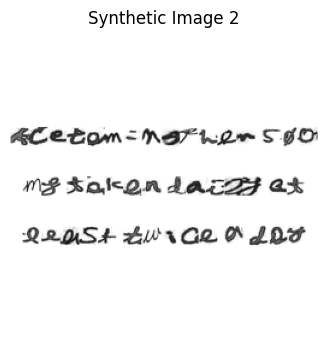

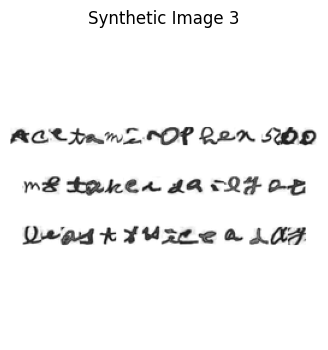

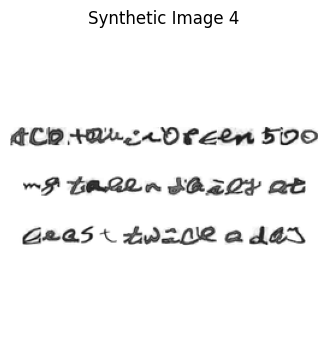

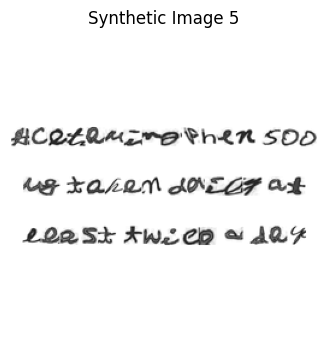

...

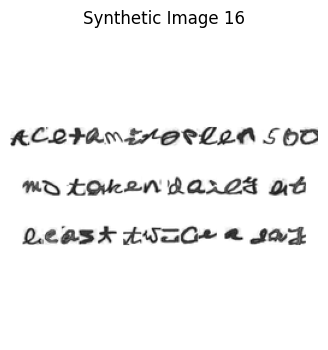

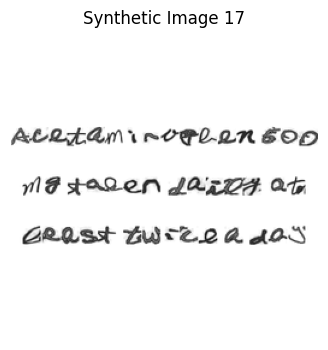

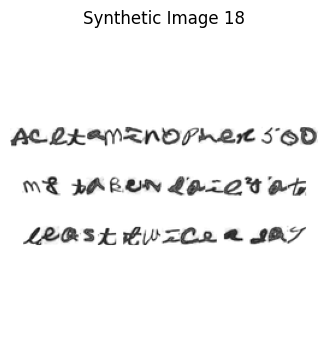

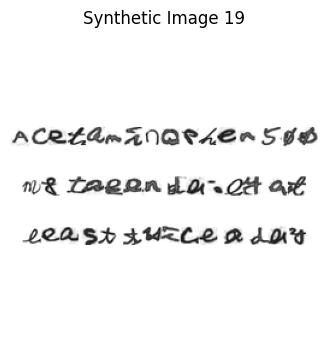

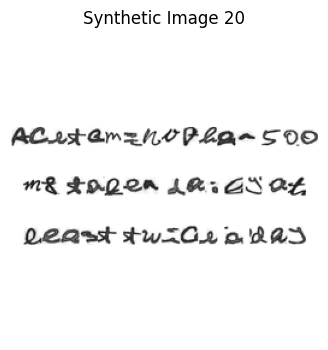

20 synthetic images have been generated and saved.


In [12]:
import os
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from scipy.ndimage import shift as scipy_shift

DATA_PATH = 'data'

with open('label.txt', 'r') as f:
    labels = f.read().splitlines()

label_to_folder = {label: str(i) for i, label in enumerate(labels)}

def load_character_images():
    char_images = {}
    for label, folder in label_to_folder.items():
        folder_path = os.path.join(DATA_PATH, folder)
        images = []
        for img_file in os.listdir(folder_path):
            if img_file.endswith('.png'):
                img_path = os.path.join(folder_path, img_file)
                img = Image.open(img_path).convert('L')  # Convert to grayscale
                images.append(np.array(img))
        char_images[label] = images
    return char_images

def random_rotation(image, max_angle=5):
    angle = random.uniform(-max_angle, max_angle)
    return Image.fromarray(image).rotate(angle, resample=Image.BILINEAR, expand=False)

def random_shift(image, max_shift=1):
    shift_x = random.randint(-max_shift, max_shift)
    shift_y = random.randint(-max_shift, max_shift)
    return scipy_shift(image, (shift_y, shift_x), cval=255)

def scale_image(image, max_size=32):
    h, w = image.shape
    scale = min(max_size / max(h, w), 1)
    new_h, new_w = int(h * scale), int(w * scale)
    return Image.fromarray(image).resize((new_w, new_h), Image.LANCZOS)

def generate_line(text, char_images, line_height=64, space_width=10):
    line_image = Image.new('L', (1, line_height), color=255)
    
    for char in text:
        if char == ' ':
            space = Image.new('L', (space_width, line_height), color=255)
            new_width = line_image.width + space.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(space, (line_image.width, 0))
            line_image = new_image
        elif char in char_images:
            char_img = random.choice(char_images[char])
            char_img = scale_image(char_img)
            char_img = random_rotation(np.array(char_img))
            char_img = random_shift(char_img)
            char_img = Image.fromarray(char_img)
            
            new_width = line_image.width + char_img.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(char_img, (line_image.width, (line_height - char_img.height) // 2), char_img)
            line_image = new_image
        else:
            print(f"Character '{char}' not found in char_images")
    
    return line_image


def join_units(text):
    words = text.split()
    combined_words = []
    
    i = 0
    while i < len(words):
        if words[i].isdigit() and i + 1 < len(words) and words[i + 1] in ['mg', 'ml']:
            combined_words.append(f"{words[i]} {words[i + 1]}")  # Join number and unit
            i += 2  # Skip the next word (mg/ml)
        else:
            combined_words.append(words[i])
            i += 1
    return ' '.join(combined_words)

def generate_multiline_image(text, char_images, max_width=512, line_spacing=10):
    text = join_units(text)  # Ensure 'mg' and 'ml' are joined with the preceding number
    words = text.split()
    lines = []
    current_line = []
    
    for word in words:
        test_line = current_line + [word]
        test_image = generate_line(' '.join(test_line), char_images)
        
        if test_image.width <= max_width:
            current_line.append(word)
        else:
            if current_line:
                lines.append(' '.join(current_line))
                current_line = [word]
            else:
                lines.append(word)
                current_line = []
    
    if current_line:
        lines.append(' '.join(current_line))
    
    # Calculate the maximum line width to ensure no cropping
    line_images = [generate_line(line, char_images) for line in lines]
    max_line_width = max(img.width for img in line_images)
    total_height = sum(img.height for img in line_images) + line_spacing * (len(line_images) - 1)
    
    # Ensure the image width doesn't exceed the max width, with some padding
    target_width = min(max(max_line_width, 256), max_width)
    
    # Create a new multiline image canvas based on calculated dimensions
    multiline_image = Image.new('L', (target_width, total_height), color=255)
    y_offset = 0
    
    for line_img in line_images:
        multiline_image.paste(line_img, ((target_width - line_img.width) // 2, y_offset))
        y_offset += line_img.height + line_spacing
    
    # Resize the multiline image to fit within 256x256, but only if necessary
    if multiline_image.width > 256 or multiline_image.height > 256:
        aspect_ratio = multiline_image.width / multiline_image.height
        if aspect_ratio > 1:
            new_width = 256
            new_height = int(256 / aspect_ratio)
        else:
            new_height = 256
            new_width = int(256 * aspect_ratio)
        
        resized_image = multiline_image.resize((new_width, new_height), Image.LANCZOS)
    else:
        resized_image = multiline_image
    
    # Create the final image canvas and paste the resized image with padding
    final_image = Image.new('L', (256, 256), color=255)
    final_image.paste(resized_image, ((256 - resized_image.width) // 2, (256 - resized_image.height) // 2))
    
    return final_image


# Load character images
char_images = load_character_images()

# Generate synthetic data with new sentence
text = "Acetaminophen 500 mg taken daily at least twice a day"
num_images = 20

for i in range(num_images):
    image = generate_multiline_image(text, char_images)
    image.save(f'synthetic_image_harder_{i+1}.png')
    
    plt.figure(figsize=(4, 4))
    plt.imshow(image, cmap='gray')
    plt.axis('off') 
    plt.title(f'Synthetic Image {i+1}')
    plt.show()

print(f"{num_images} synthetic images have been generated and saved.")

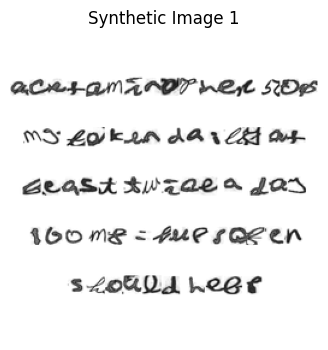

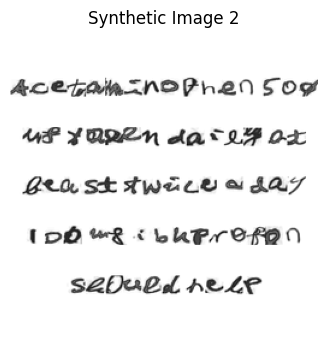

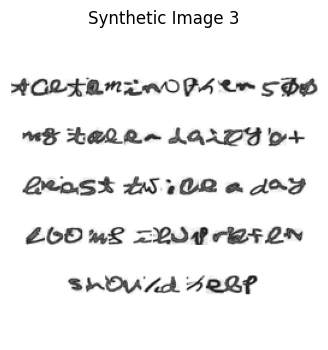

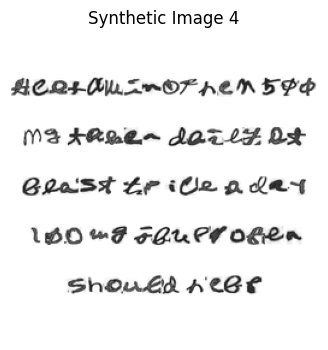

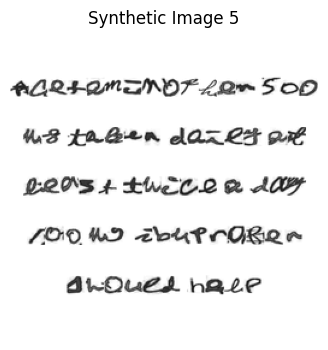

...

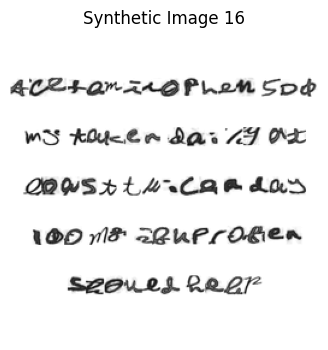

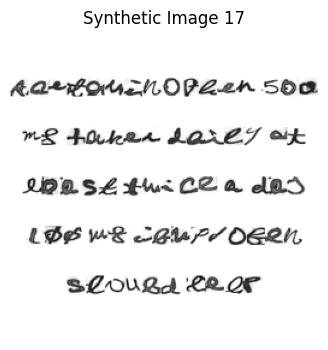

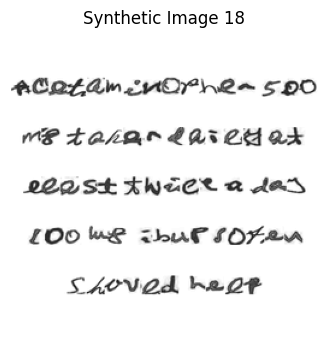

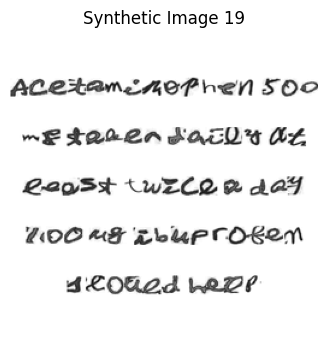

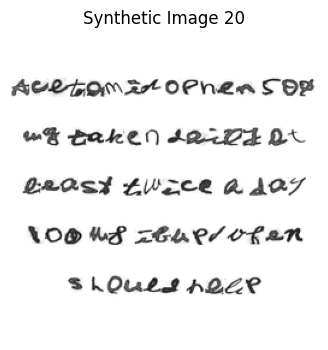

20 synthetic images have been generated and saved.


In [14]:
import os
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from scipy.ndimage import shift as scipy_shift

DATA_PATH = 'data'

with open('label.txt', 'r') as f:
    labels = f.read().splitlines()

label_to_folder = {label: str(i) for i, label in enumerate(labels)}

def load_character_images():
    char_images = {}
    for label, folder in label_to_folder.items():
        folder_path = os.path.join(DATA_PATH, folder)
        images = []
        for img_file in os.listdir(folder_path):
            if img_file.endswith('.png'):
                img_path = os.path.join(folder_path, img_file)
                img = Image.open(img_path).convert('L')  # Convert to grayscale
                images.append(np.array(img))
        char_images[label] = images
    return char_images

def random_rotation(image, max_angle=5):
    angle = random.uniform(-max_angle, max_angle)
    return Image.fromarray(image).rotate(angle, resample=Image.BILINEAR, expand=False)

def random_shift(image, max_shift=1):
    shift_x = random.randint(-max_shift, max_shift)
    shift_y = random.randint(-max_shift, max_shift)
    return scipy_shift(image, (shift_y, shift_x), cval=255)

def scale_image(image, max_size=32):
    h, w = image.shape
    scale = min(max_size / max(h, w), 1)
    new_h, new_w = int(h * scale), int(w * scale)
    return Image.fromarray(image).resize((new_w, new_h), Image.LANCZOS)

def generate_line(text, char_images, line_height=64, space_width=10):
    line_image = Image.new('L', (1, line_height), color=255)
    
    for char in text:
        if char == ' ':
            space = Image.new('L', (space_width, line_height), color=255)
            new_width = line_image.width + space.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(space, (line_image.width, 0))
            line_image = new_image
        elif char in char_images:
            char_img = random.choice(char_images[char])
            char_img = scale_image(char_img)
            char_img = random_rotation(np.array(char_img))
            char_img = random_shift(char_img)
            char_img = Image.fromarray(char_img)
            
            new_width = line_image.width + char_img.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(char_img, (line_image.width, (line_height - char_img.height) // 2), char_img)
            line_image = new_image
        else:
            print(f"Character '{char}' not found in char_images")
    
    return line_image


def join_units(text):
    words = text.split()
    combined_words = []
    
    i = 0
    while i < len(words):
        if words[i].isdigit() and i + 1 < len(words) and words[i + 1] in ['mg', 'ml']:
            combined_words.append(f"{words[i]} {words[i + 1]}")  # Join number and unit
            i += 2  # Skip the next word (mg/ml)
        else:
            combined_words.append(words[i])
            i += 1
    return ' '.join(combined_words)

def generate_multiline_image(text, char_images, max_width=512, line_spacing=10):
    text = join_units(text)  # Ensure 'mg' and 'ml' are joined with the preceding number
    words = text.split()
    lines = []
    current_line = []
    
    for word in words:
        test_line = current_line + [word]
        test_image = generate_line(' '.join(test_line), char_images)
        
        if test_image.width <= max_width:
            current_line.append(word)
        else:
            if current_line:
                lines.append(' '.join(current_line))
                current_line = [word]
            else:
                lines.append(word)
                current_line = []
    
    if current_line:
        lines.append(' '.join(current_line))
    
    # Calculate the maximum line width to ensure no cropping
    line_images = [generate_line(line, char_images) for line in lines]
    max_line_width = max(img.width for img in line_images)
    total_height = sum(img.height for img in line_images) + line_spacing * (len(line_images) - 1)
    
    # Ensure the image width doesn't exceed the max width, with some padding
    target_width = min(max(max_line_width, 256), max_width)
    
    # Create a new multiline image canvas based on calculated dimensions
    multiline_image = Image.new('L', (target_width, total_height), color=255)
    y_offset = 0
    
    for line_img in line_images:
        multiline_image.paste(line_img, ((target_width - line_img.width) // 2, y_offset))
        y_offset += line_img.height + line_spacing
    
    # Resize the multiline image to fit within 256x256, but only if necessary
    if multiline_image.width > 256 or multiline_image.height > 256:
        aspect_ratio = multiline_image.width / multiline_image.height
        if aspect_ratio > 1:
            new_width = 256
            new_height = int(256 / aspect_ratio)
        else:
            new_height = 256
            new_width = int(256 * aspect_ratio)
        
        resized_image = multiline_image.resize((new_width, new_height), Image.LANCZOS)
    else:
        resized_image = multiline_image
    
    # Create the final image canvas and paste the resized image with padding
    final_image = Image.new('L', (256, 256), color=255)
    final_image.paste(resized_image, ((256 - resized_image.width) // 2, (256 - resized_image.height) // 2))
    
    return final_image


# Load character images
char_images = load_character_images()

# Generate synthetic data with new sentence
text = "Acetaminophen 500 mg taken daily at least twice a day 100 mg ibuprofen should help"
num_images = 20

for i in range(num_images):
    image = generate_multiline_image(text, char_images)
    image.save(f'synthetic_image_harder_{i+1}.png')
    
    plt.figure(figsize=(4, 4))
    plt.imshow(image, cmap='gray')
    plt.axis('off') 
    plt.title(f'Synthetic Image {i+1}')
    plt.show()

print(f"{num_images} synthetic images have been generated and saved.")

Synthetic Image 1 Text Representation:
Acetaminophen 500
mg taken daily at
least twice a day
100 mg ibuprofen
should help



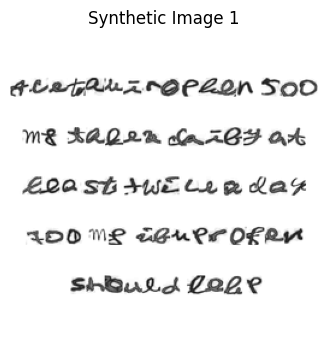

Synthetic Image 2 Text Representation:
Acetaminophen 500
mg taken daily at
least twice a day
100 mg ibuprofen
should help



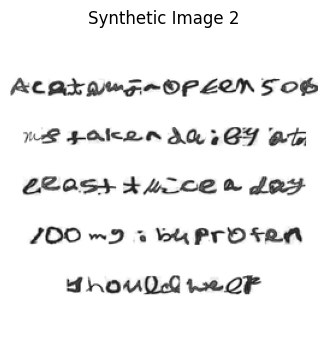

Synthetic Image 3 Text Representation:
Acetaminophen 500
mg taken daily at
least twice a day
100 mg ibuprofen
should help



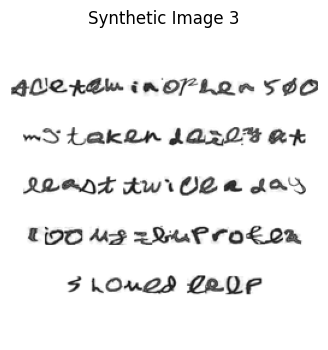

Synthetic Image 4 Text Representation:
Acetaminophen 500
mg taken daily at
least twice a day
100 mg ibuprofen
should help



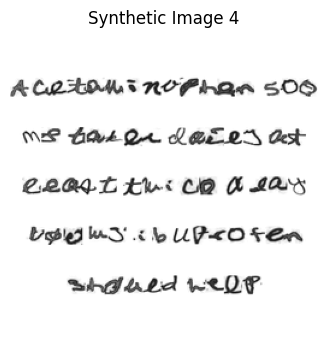

Synthetic Image 5 Text Representation:
Acetaminophen 500
mg taken daily at
least twice a day
100 mg ibuprofen
should help



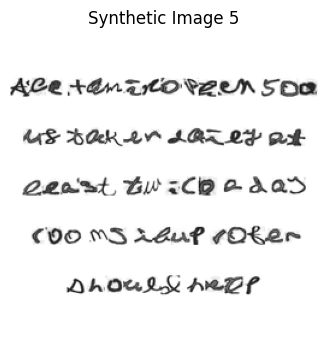

Synthetic Image 6 Text Representation:
Acetaminophen 500
mg taken daily at
least twice a day
100 mg ibuprofen
should help



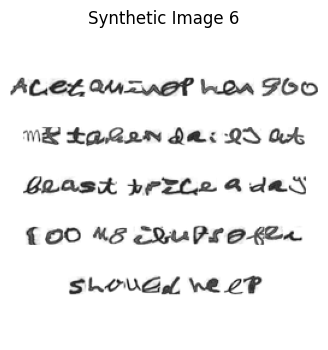

Synthetic Image 7 Text Representation:
Acetaminophen 500
mg taken daily at
least twice a day
100 mg ibuprofen
should help



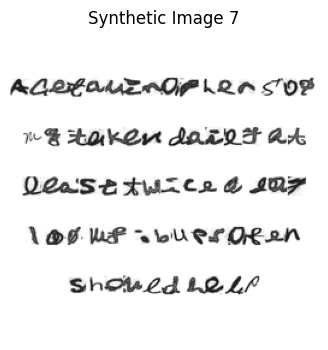

Synthetic Image 8 Text Representation:
Acetaminophen 500
mg taken daily at
least twice a day
100 mg ibuprofen
should help



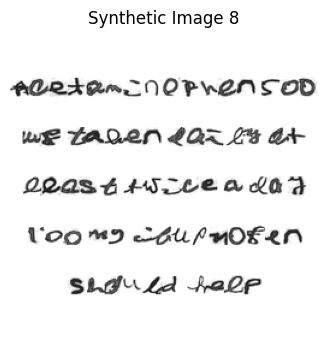

Synthetic Image 9 Text Representation:
Acetaminophen 500
mg taken daily at
least twice a day
100 mg ibuprofen
should help



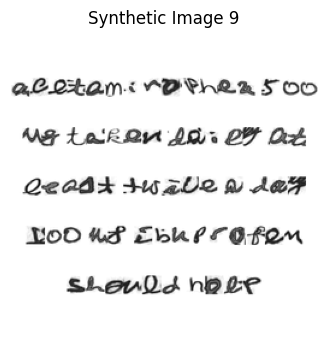

Synthetic Image 10 Text Representation:
Acetaminophen 500
mg taken daily at
least twice a day
100 mg ibuprofen
should help



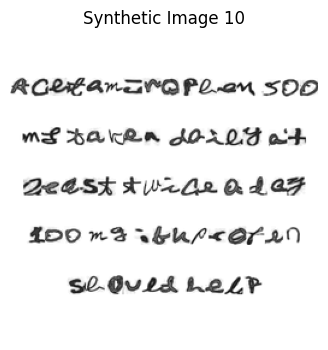

Synthetic Image 11 Text Representation:
Acetaminophen 500
mg taken daily at
least twice a day
100 mg ibuprofen
should help



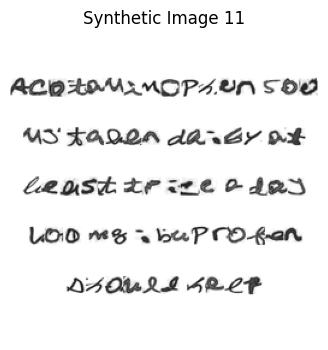

Synthetic Image 12 Text Representation:
Acetaminophen 500
mg taken daily at
least twice a day
100 mg ibuprofen
should help



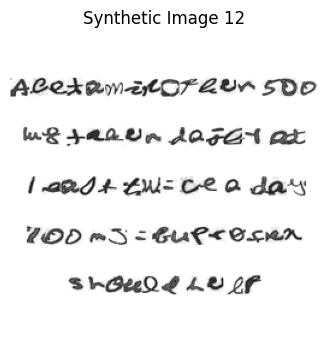

Synthetic Image 13 Text Representation:
Acetaminophen 500
mg taken daily at
least twice a day
100 mg ibuprofen
should help



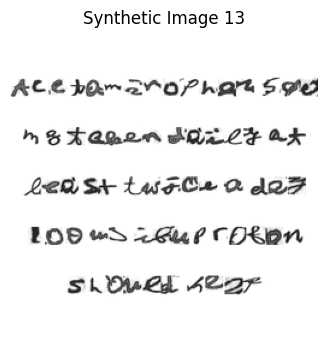

Synthetic Image 14 Text Representation:
Acetaminophen 500
mg taken daily at
least twice a day
100 mg ibuprofen
should help



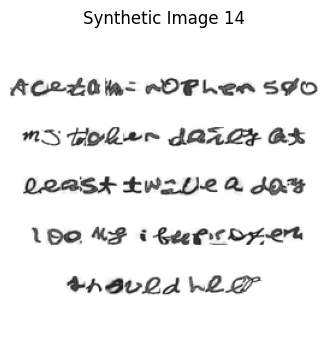

Synthetic Image 15 Text Representation:
Acetaminophen 500
mg taken daily at
least twice a day
100 mg ibuprofen
should help



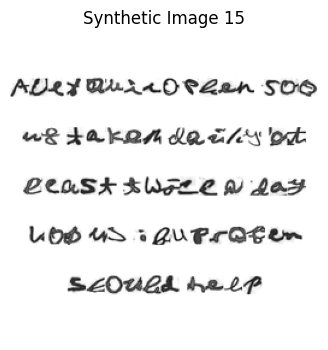

Synthetic Image 16 Text Representation:
Acetaminophen 500
mg taken daily at
least twice a day
100 mg ibuprofen
should help



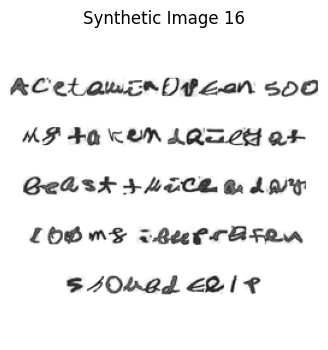

Synthetic Image 17 Text Representation:
Acetaminophen 500
mg taken daily at
least twice a day
100 mg ibuprofen
should help



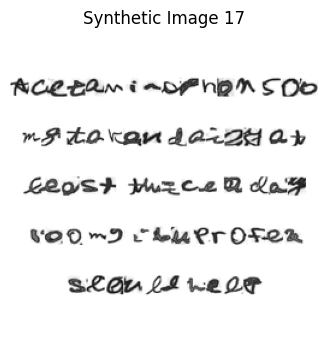

Synthetic Image 18 Text Representation:
Acetaminophen 500
mg taken daily at
least twice a day
100 mg ibuprofen
should help



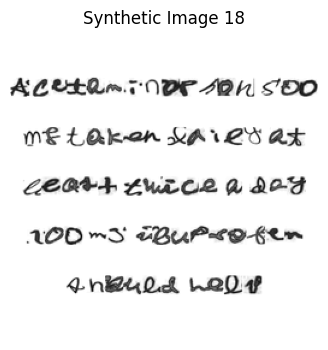

Synthetic Image 19 Text Representation:
Acetaminophen 500
mg taken daily at
least twice a day
100 mg ibuprofen
should help



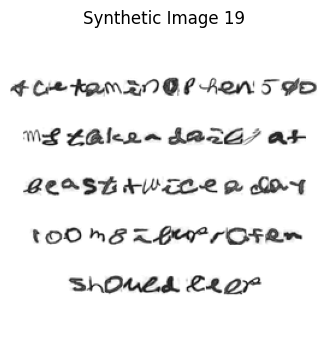

Synthetic Image 20 Text Representation:
Acetaminophen 500
mg taken daily at
least twice a day
100 mg ibuprofen
should help



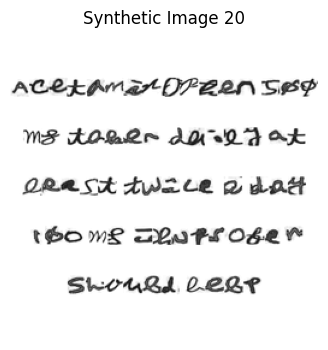

20 synthetic images have been generated and saved.


In [15]:
def generate_multiline_image_with_text(text, char_images, max_width=512, line_spacing=10):
    text = join_units(text)  # Ensure 'mg' and 'ml' are joined with the preceding number
    words = text.split()
    lines = []
    current_line = []
    
    for word in words:
        test_line = current_line + [word]
        test_image = generate_line(' '.join(test_line), char_images)
        
        if test_image.width <= max_width:
            current_line.append(word)
        else:
            if current_line:
                lines.append(' '.join(current_line))
                current_line = [word]
            else:
                lines.append(word)
                current_line = []
    
    if current_line:
        lines.append(' '.join(current_line))
    
    # Generate line images as usual
    line_images = [generate_line(line, char_images) for line in lines]
    max_line_width = max(img.width for img in line_images)
    total_height = sum(img.height for img in line_images) + line_spacing * (len(line_images) - 1)
    
    target_width = min(max(max_line_width, 256), max_width)
    multiline_image = Image.new('L', (target_width, total_height), color=255)
    y_offset = 0
    
    for line_img in line_images:
        multiline_image.paste(line_img, ((target_width - line_img.width) // 2, y_offset))
        y_offset += line_img.height + line_spacing
    
    # Resize the multiline image if necessary
    if multiline_image.width > 256 or multiline_image.height > 256:
        aspect_ratio = multiline_image.width / multiline_image.height
        if aspect_ratio > 1:
            new_width = 256
            new_height = int(256 / aspect_ratio)
        else:
            new_height = 256
            new_width = int(256 * aspect_ratio)
        
        resized_image = multiline_image.resize((new_width, new_height), Image.LANCZOS)
    else:
        resized_image = multiline_image
    
    # Create the final image canvas and paste the resized image
    final_image = Image.new('L', (256, 256), color=255)
    final_image.paste(resized_image, ((256 - resized_image.width) // 2, (256 - resized_image.height) // 2))
    
    # Return both the final image and the text representation with new line escape
    text_representation = '\n'.join(lines)
    
    return final_image, text_representation

# Example usage
for i in range(num_images):
    image, text_output = generate_multiline_image_with_text(text, char_images)
    image.save(f'synthetic_image_harder_{i+1}.png')
    
    # Print the text output with new line escapes
    print(f"Synthetic Image {i+1} Text Representation:\n{text_output}\n")
    
    plt.figure(figsize=(4, 4))
    plt.imshow(image, cmap='gray')
    plt.axis('off') 
    plt.title(f'Synthetic Image {i+1}')
    plt.show()

print(f"{num_images} synthetic images have been generated and saved.")


Synthetic Image 1 Text Representation:
Acetaminophen
500 mg
taken daily at least
twice a day
100 mg ibuprofen
should help



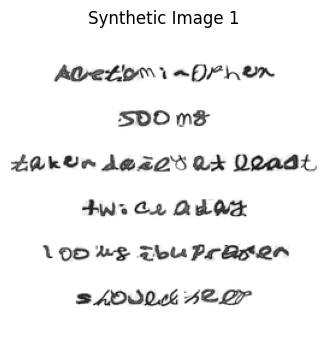

Synthetic Image 2 Text Representation:
Acetaminophen
500 mg taken daily
at
least twice a
day 100 mg
ibuprofen should
help



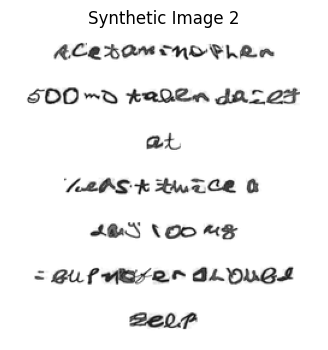

Synthetic Image 3 Text Representation:
Acetaminophen
500 mg taken daily
at
least twice a day
100 mg
ibuprofen should
help



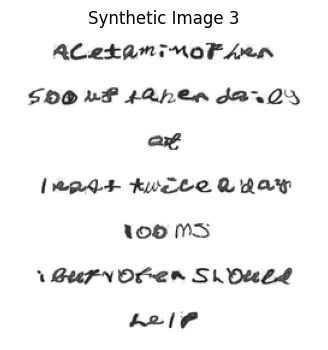

Synthetic Image 4 Text Representation:
Acetaminophen
500 mg taken daily
at least twice a day
100 mg ibuprofen
should help



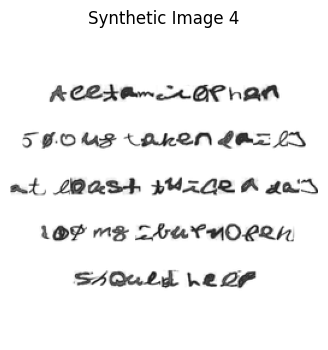

Synthetic Image 5 Text Representation:
Acetaminophen
500 mg
taken daily
at least twice
a day 100 mg
ibuprofen should
help



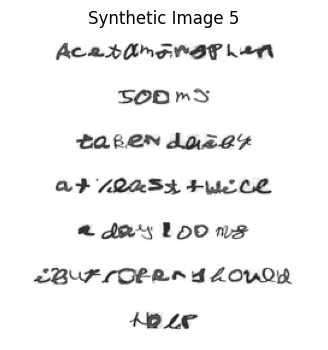

Synthetic Image 6 Text Representation:
Acetaminophen
500 mg
taken
daily at
least
twice a
day
100 mg ibuprofen
should
help



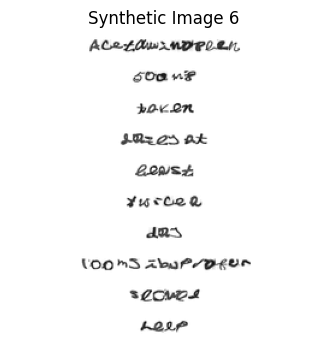

Synthetic Image 7 Text Representation:
Acetaminophen
500 mg
taken daily at
least twice a day
100 mg ibuprofen
should
help



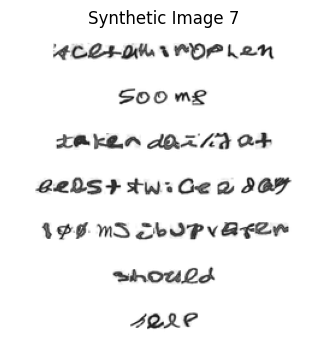

Synthetic Image 8 Text Representation:
Acetaminophen
500 mg taken daily
at least twice a
day
100 mg ibuprofen
should
help



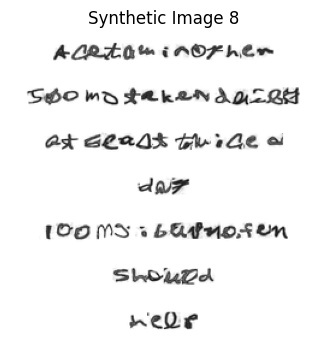

Synthetic Image 9 Text Representation:
Acetaminophen
500 mg taken daily
at
least twice a
day 100 mg ibuprofen
should help



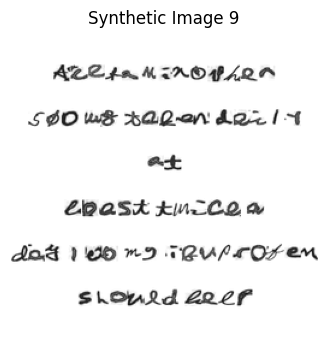

Synthetic Image 10 Text Representation:
Acetaminophen
500 mg
taken
daily at
least twice a day
100 mg ibuprofen
should help



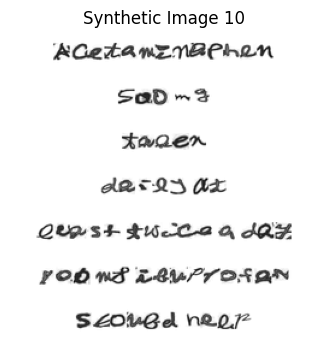

10 synthetic image variants with fixed units have been generated and saved.


In [22]:
def generate_multiline_image_with_fixed_units(text, char_images, max_width=512, line_spacing=10):
    # Join units with their preceding numbers
    text = join_units(text)  # Ensure 'mg' and 'ml' are joined with the preceding number
    words = text.split()
    lines = []
    current_line = []
    
    i = 0  # Explicitly manage the index to handle skips
    while i < len(words):
        word = words[i]
        
        # Ensure number + unit (e.g., "500 mg") stays together on the same line
        if word.isdigit() and i + 1 < len(words) and words[i + 1] in ['mg', 'ml']:
            word = f"{word} {words[i + 1]}"  # Combine number and unit
            i += 1  # Skip the next word (the unit)

        test_line = current_line + [word]
        test_image = generate_line(' '.join(test_line), char_images)

        if test_image.width <= max_width and random.random() > 0.3:  # Simplified split probability
            current_line.append(word)
        else:
            if current_line:
                lines.append(' '.join(current_line))
                current_line = [word]
            else:
                lines.append(word)
                current_line = []

        i += 1  # Move to the next word

    if current_line:
        lines.append(' '.join(current_line))

    # Generate line images as usual
    line_images = [generate_line(line, char_images) for line in lines]
    max_line_width = max(img.width for img in line_images)
    total_height = sum(img.height for img in line_images) + line_spacing * (len(line_images) - 1)

    target_width = min(max(max_line_width, 256), max_width)
    multiline_image = Image.new('L', (target_width, total_height), color=255)
    y_offset = 0

    for line_img in line_images:
        multiline_image.paste(line_img, ((target_width - line_img.width) // 2, y_offset))
        y_offset += line_img.height + line_spacing

    # Resize the multiline image if necessary
    if multiline_image.width > 256 or multiline_image.height > 256:
        aspect_ratio = multiline_image.width / multiline_image.height
        if aspect_ratio > 1:
            new_width = 256
            new_height = int(256 / aspect_ratio)
        else:
            new_height = 256
            new_width = int(256 * aspect_ratio)

        resized_image = multiline_image.resize((new_width, new_height), Image.LANCZOS)
    else:
        resized_image = multiline_image

    # Create the final image canvas and paste the resized image
    final_image = Image.new('L', (256, 256), color=255)
    final_image.paste(resized_image, ((256 - resized_image.width) // 2, (256 - resized_image.height) // 2))

    # Return both the final image and the text representation with new line escape
    text_representation = '\n'.join(lines)

    return final_image, text_representation

# Generate 10 different new line splits with fixed number-unit pairs
num_variations = 10
for i in range(num_variations):
    image, text_output = generate_multiline_image_with_fixed_units(text, char_images)
    image.save(f'synthetic_image_variant_fixed_units_{i+1}.png')
    
    # Print the text output with new line escapes
    print(f"Synthetic Image {i+1} Text Representation:\n{text_output}\n")
    
    plt.figure(figsize=(4, 4))
    plt.imshow(image, cmap='gray')
    plt.axis('off') 
    plt.title(f'Synthetic Image {i+1}')
    plt.show()

print(f"{num_variations} synthetic image variants with fixed units have been generated and saved.")


Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images


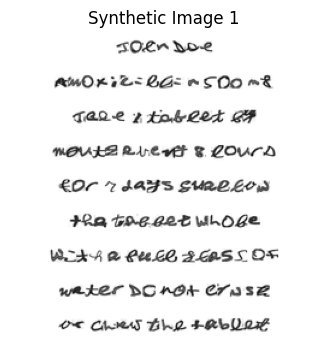

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images


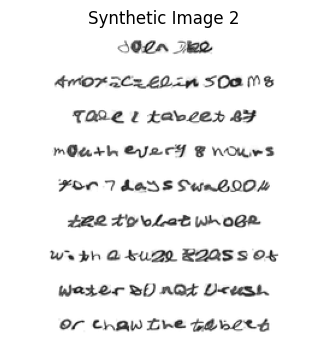

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images


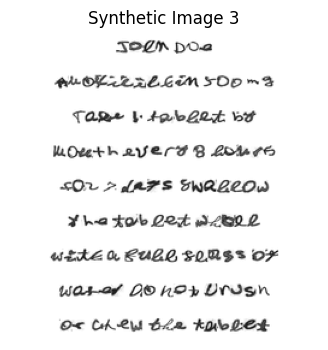

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images


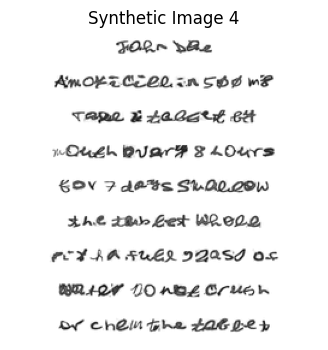

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images


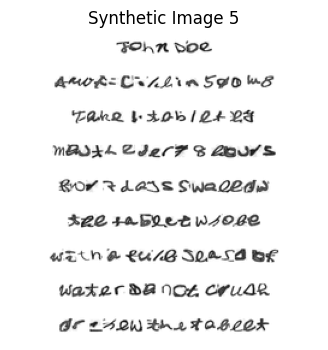

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images


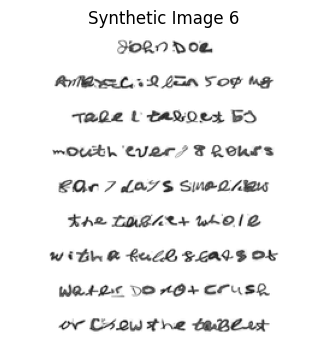

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images


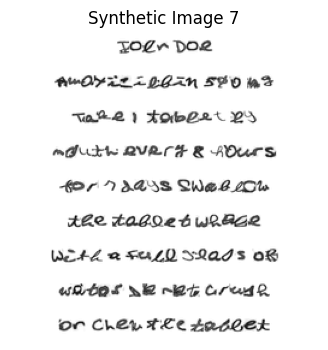

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images


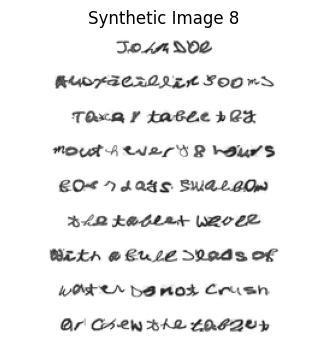

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images


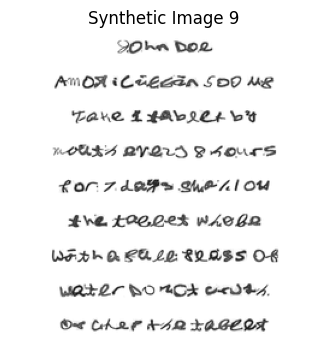

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images


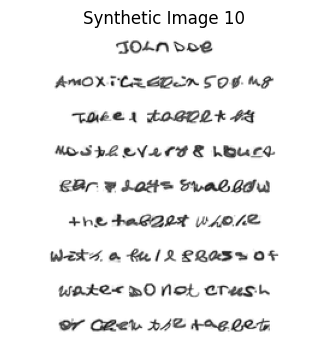

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images


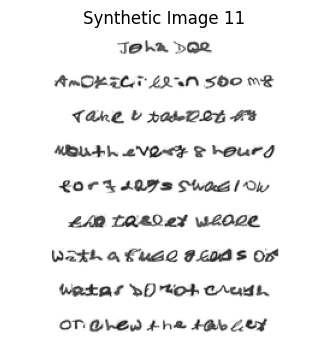

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images


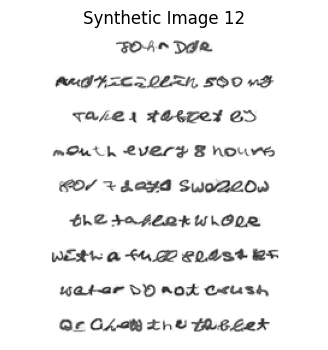

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images


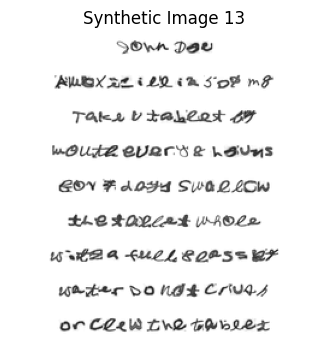

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images


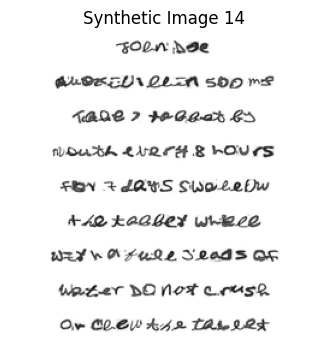

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images


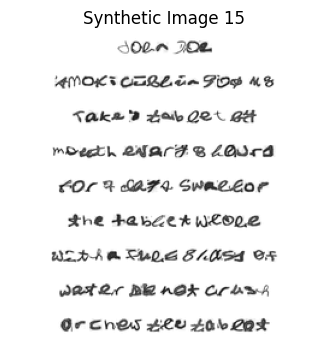

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images


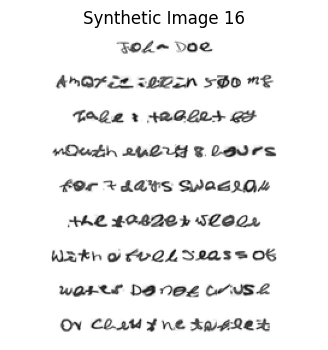

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images


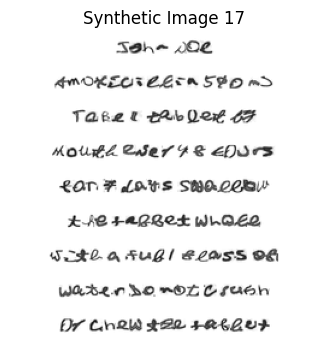

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images


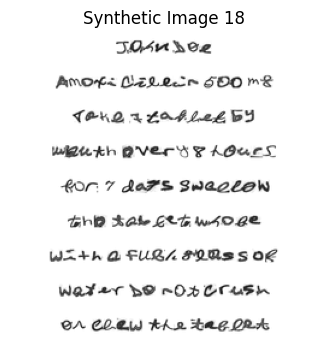

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images


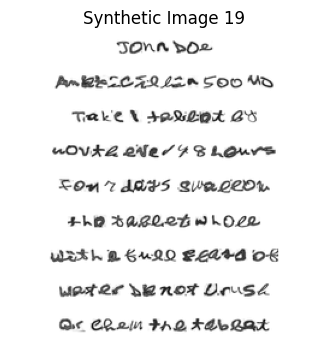

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images


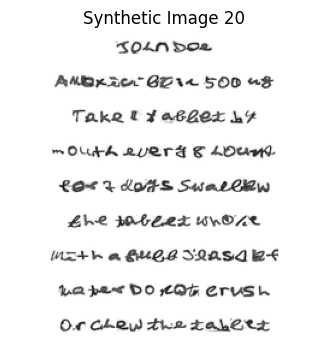

20 synthetic images have been generated and saved.
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Synthetic Image 1 Text Representation:
John
Doe
Amoxicillin 500 mg
Take 1
tablet
by mouth
every 8 hours
for 7 days.
Swallow the tablet
whole with a full
glass of water.
Do not crush or
chew
the
tablet.



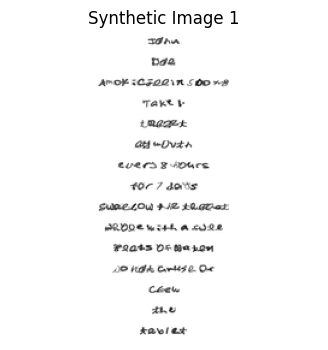

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Synthetic Image 2 Text Representation:
John Doe
Amoxicillin 500 mg
Take
1
tablet
by mouth every 8
hours for 7 days.
Swallow the
tablet whole with a
full glass of water.
Do not crush or chew
the tablet.



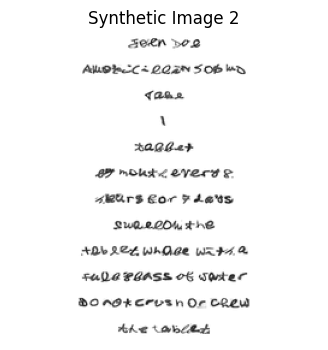

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Synthetic Image 3 Text Representation:
John
Doe
Amoxicillin 500 mg
Take
1
tablet by
mouth
every 8 hours for 7
days. Swallow the
tablet whole with a
full glass
of water.
Do not crush
or chew
the tablet.



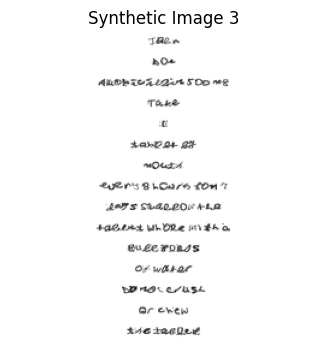

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Synthetic Image 4 Text Representation:
John Doe
Amoxicillin
500 mg Take
1
tablet
by mouth every
8 hours
for 7 days. Swallow
the tablet
whole
with a full glass of
water. Do
not crush or chew
the tablet.



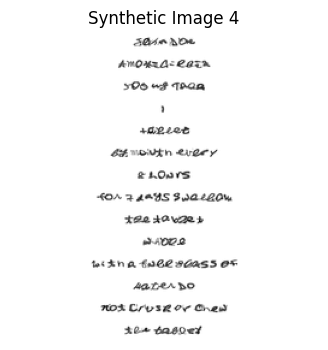

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Synthetic Image 5 Text Representation:
John
Doe
Amoxicillin
500 mg Take
1 tablet by mouth
every 8 hours for 7
days. Swallow
the
tablet whole with a
full
glass of
water. Do not
crush or chew the
tablet.



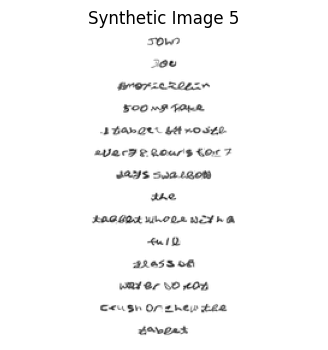

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Synthetic Image 6 Text Representation:
John Doe
Amoxicillin 500 mg
Take 1 tablet by
mouth every 8 hours
for 7 days. Swallow
the tablet whole
with
a full glass of
water. Do not crush
or chew the tablet.



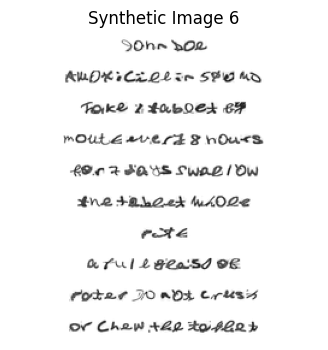

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Synthetic Image 7 Text Representation:
John
Doe
Amoxicillin 500 mg
Take
1 tablet by
mouth every
8 hours for 7 days.
Swallow the tablet
whole
with a full glass of
water. Do not crush
or chew the tablet.



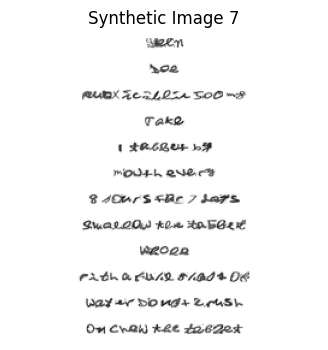

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Synthetic Image 8 Text Representation:
John
Doe Amoxicillin
500 mg
Take 1 tablet by
mouth every
8 hours
for 7 days. Swallow
the
tablet whole with a
full glass of water.
Do not crush or chew
the
tablet.



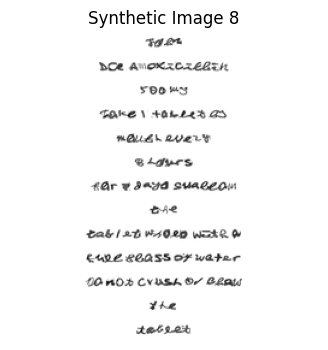

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Synthetic Image 9 Text Representation:
John Doe
Amoxicillin 500 mg
Take 1 tablet by
mouth
every 8 hours for 7
days. Swallow
the tablet whole
with
a
full glass of water.
Do not crush or chew
the tablet.



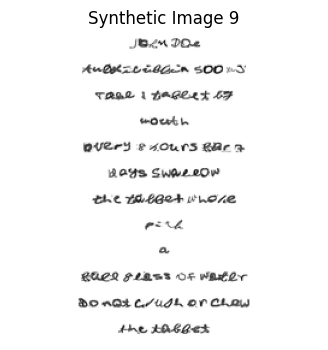

Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Character '.' not found in char_images
Synthetic Image 10 Text Representation:
John Doe
Amoxicillin 500 mg
Take
1 tablet
by mouth
every 8 hours for 7
days. Swallow the
tablet
whole
with a
full
glass
of water. Do not
crush or chew the
tablet.



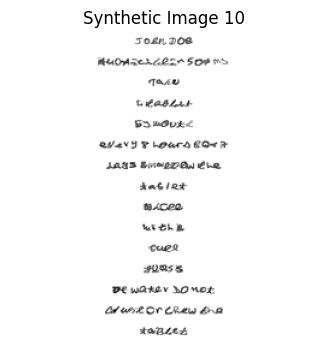

10 synthetic image variants with fixed units have been generated and saved.


In [26]:
import os
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from scipy.ndimage import shift as scipy_shift

DATA_PATH = 'data'

with open('label.txt', 'r') as f:
    labels = f.read().splitlines()

label_to_folder = {label: str(i) for i, label in enumerate(labels)}

def load_character_images():
    char_images = {}
    for label, folder in label_to_folder.items():
        folder_path = os.path.join(DATA_PATH, folder)
        images = []
        for img_file in os.listdir(folder_path):
            if img_file.endswith('.png'):
                img_path = os.path.join(folder_path, img_file)
                img = Image.open(img_path).convert('L')  # Convert to grayscale
                images.append(np.array(img))
        char_images[label] = images
    return char_images

def random_rotation(image, max_angle=5):
    angle = random.uniform(-max_angle, max_angle)
    return Image.fromarray(image).rotate(angle, resample=Image.BILINEAR, expand=False)

def random_shift(image, max_shift=1):
    shift_x = random.randint(-max_shift, max_shift)
    shift_y = random.randint(-max_shift, max_shift)
    return scipy_shift(image, (shift_y, shift_x), cval=255)

def scale_image(image, max_size=32):
    h, w = image.shape
    scale = min(max_size / max(h, w), 1)
    new_h, new_w = int(h * scale), int(w * scale)
    return Image.fromarray(image).resize((new_w, new_h), Image.LANCZOS)

def generate_line(text, char_images, line_height=64, space_width=10):
    line_image = Image.new('L', (1, line_height), color=255)
    
    for char in text:
        if char == ' ':
            space = Image.new('L', (space_width, line_height), color=255)
            new_width = line_image.width + space.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(space, (line_image.width, 0))
            line_image = new_image
        elif char in char_images:
            char_img = random.choice(char_images[char])
            char_img = scale_image(char_img)
            char_img = random_rotation(np.array(char_img))
            char_img = random_shift(char_img)
            char_img = Image.fromarray(char_img)
            
            new_width = line_image.width + char_img.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(char_img, (line_image.width, (line_height - char_img.height) // 2), char_img)
            line_image = new_image
        else:
            print(f"Character '{char}' not found in char_images")
    
    return line_image


def join_units(text):
    words = text.split()
    combined_words = []
    
    i = 0
    while i < len(words):
        if words[i].isdigit() and i + 1 < len(words) and words[i + 1] in ['mg', 'ml']:
            combined_words.append(f"{words[i]} {words[i + 1]}")  # Join number and unit
            i += 2  # Skip the next word (mg/ml)
        else:
            combined_words.append(words[i])
            i += 1
    return ' '.join(combined_words)

def generate_multiline_image(text, char_images, max_width=512, line_spacing=10):
    text = join_units(text)  # Ensure 'mg' and 'ml' are joined with the preceding number
    words = text.split()
    lines = []
    current_line = []
    
    for word in words:
        test_line = current_line + [word]
        test_image = generate_line(' '.join(test_line), char_images)
        
        if test_image.width <= max_width:
            current_line.append(word)
        else:
            if current_line:
                lines.append(' '.join(current_line))
                current_line = [word]
            else:
                lines.append(word)
                current_line = []
    
    if current_line:
        lines.append(' '.join(current_line))
    
    # Calculate the maximum line width to ensure no cropping
    line_images = [generate_line(line, char_images) for line in lines]
    max_line_width = max(img.width for img in line_images)
    total_height = sum(img.height for img in line_images) + line_spacing * (len(line_images) - 1)
    
    # Ensure the image width doesn't exceed the max width, with some padding
    target_width = min(max(max_line_width, 256), max_width)
    
    # Create a new multiline image canvas based on calculated dimensions
    multiline_image = Image.new('L', (target_width, total_height), color=255)
    y_offset = 0
    
    for line_img in line_images:
        multiline_image.paste(line_img, ((target_width - line_img.width) // 2, y_offset))
        y_offset += line_img.height + line_spacing
    
    # Resize the multiline image to fit within 256x256, but only if necessary
    if multiline_image.width > 256 or multiline_image.height > 256:
        aspect_ratio = multiline_image.width / multiline_image.height
        if aspect_ratio > 1:
            new_width = 256
            new_height = int(256 / aspect_ratio)
        else:
            new_height = 256
            new_width = int(256 * aspect_ratio)
        
        resized_image = multiline_image.resize((new_width, new_height), Image.LANCZOS)
    else:
        resized_image = multiline_image
    
    # Create the final image canvas and paste the resized image with padding
    final_image = Image.new('L', (256, 256), color=255)
    final_image.paste(resized_image, ((256 - resized_image.width) // 2, (256 - resized_image.height) // 2))
    
    return final_image

def generate_multiline_image_with_fixed_units(text, char_images, max_width=512, line_spacing=10):
    # Join units with their preceding numbers
    text = join_units(text)  # Ensure 'mg' and 'ml' are joined with the preceding number
    words = text.split()
    lines = []
    current_line = []
    
    i = 0  # Explicitly manage the index to handle skips
    while i < len(words):
        word = words[i]
        
        # Ensure number + unit (e.g., "500 mg") stays together on the same line
        if word.isdigit() and i + 1 < len(words) and words[i + 1] in ['mg', 'ml']:
            word = f"{word} {words[i + 1]}"  # Combine number and unit
            i += 1  # Skip the next word (the unit)

        test_line = current_line + [word]
        test_image = generate_line(' '.join(test_line), char_images)

        if test_image.width <= max_width and random.random() > 0.3:  # Simplified split probability
            current_line.append(word)
        else:
            if current_line:
                lines.append(' '.join(current_line))
                current_line = [word]
            else:
                lines.append(word)
                current_line = []

        i += 1  # Move to the next word

    if current_line:
        lines.append(' '.join(current_line))

    # Generate line images as usual
    line_images = [generate_line(line, char_images) for line in lines]
    max_line_width = max(img.width for img in line_images)
    total_height = sum(img.height for img in line_images) + line_spacing * (len(line_images) - 1)

    target_width = min(max(max_line_width, 256), max_width)
    multiline_image = Image.new('L', (target_width, total_height), color=255)
    y_offset = 0

    for line_img in line_images:
        multiline_image.paste(line_img, ((target_width - line_img.width) // 2, y_offset))
        y_offset += line_img.height + line_spacing

    # Resize the multiline image if necessary
    if multiline_image.width > 256 or multiline_image.height > 256:
        aspect_ratio = multiline_image.width / multiline_image.height
        if aspect_ratio > 1:
            new_width = 256
            new_height = int(256 / aspect_ratio)
        else:
            new_height = 256
            new_width = int(256 * aspect_ratio)

        resized_image = multiline_image.resize((new_width, new_height), Image.LANCZOS)
    else:
        resized_image = multiline_image

    # Create the final image canvas and paste the resized image
    final_image = Image.new('L', (256, 256), color=255)
    final_image.paste(resized_image, ((256 - resized_image.width) // 2, (256 - resized_image.height) // 2))

    # Return both the final image and the text representation with new line escape
    text_representation = '\n'.join(lines)

    return final_image, text_representation

# Load character images
char_images = load_character_images()

# Generate synthetic data with new sentence
text = "John Doe Amoxicillin 500 mg Take 1 tablet by mouth every 8 hours for 7 days. Swallow the tablet whole with a full glass of water. Do not crush or chew the tablet."
num_images = 20

for i in range(num_images):
    image = generate_multiline_image(text, char_images)
    image.save(f'synthetic_image_harder_{i+1}.png')
    
    plt.figure(figsize=(4, 4))
    plt.imshow(image, cmap='gray')
    plt.axis('off') 
    plt.title(f'Synthetic Image {i+1}')
    plt.show()

print(f"{num_images} synthetic images have been generated and saved.")

# Generate 10 different new line splits with fixed number-unit pairs
num_variations = 10
for i in range(num_variations):
    image, text_output = generate_multiline_image_with_fixed_units(text, char_images)
    image.save(f'synthetic_image_variant_fixed_units_{i+1}.png')
    
    # Print the text output with new line escapes
    print(f"Synthetic Image {i+1} Text Representation:\n{text_output}\n")
    
    plt.figure(figsize=(4, 4))
    plt.imshow(image, cmap='gray')
    plt.axis('off') 
    plt.title(f'Synthetic Image {i+1}')
    plt.show()

print(f"{num_variations} synthetic image variants with fixed units have been generated and saved.")

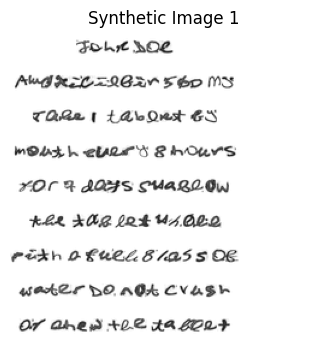

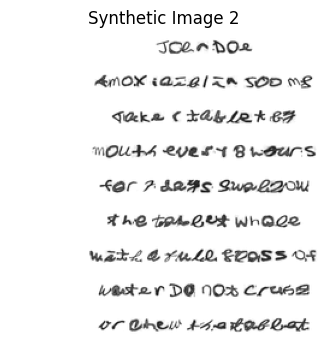

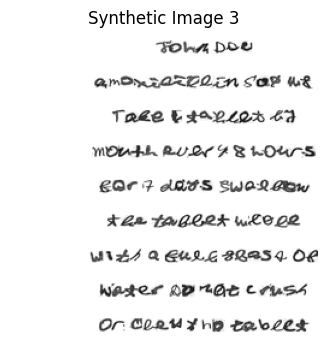

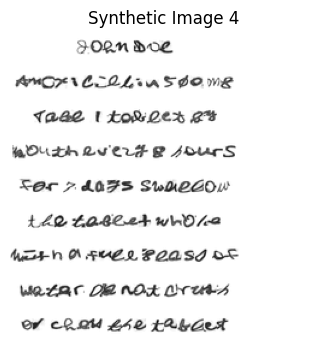

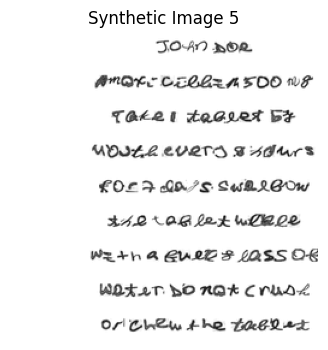

...

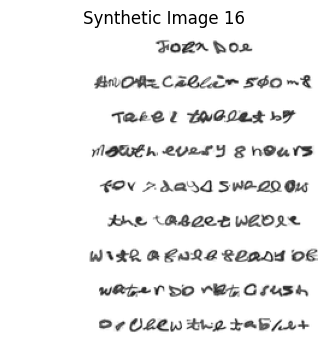

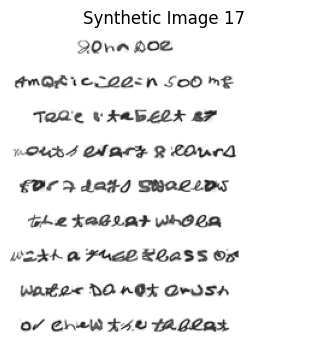

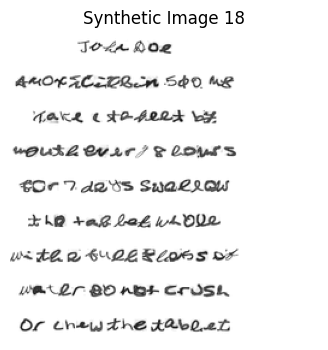

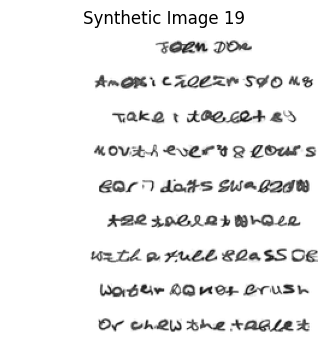

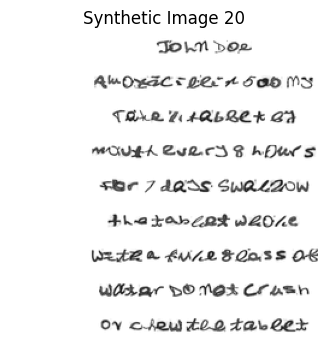

20 synthetic images have been generated and saved.


In [28]:
import os
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from scipy.ndimage import shift as scipy_shift

DATA_PATH = 'data'

with open('label.txt', 'r') as f:
    labels = f.read().splitlines()

label_to_folder = {label: str(i) for i, label in enumerate(labels)}

def load_character_images():
    char_images = {}
    for label, folder in label_to_folder.items():
        folder_path = os.path.join(DATA_PATH, folder)
        images = []
        for img_file in os.listdir(folder_path):
            if img_file.endswith('.png'):
                img_path = os.path.join(folder_path, img_file)
                img = Image.open(img_path).convert('L')  # Convert to grayscale
                images.append(np.array(img))
        char_images[label] = images
    return char_images

def random_rotation(image, max_angle=5):
    angle = random.uniform(-max_angle, max_angle)
    return Image.fromarray(image).rotate(angle, resample=Image.BILINEAR, expand=False)

def random_shift(image, max_shift=1):
    shift_x = random.randint(-max_shift, max_shift)
    shift_y = random.randint(-max_shift, max_shift)
    return scipy_shift(image, (shift_y, shift_x), cval=255)

def scale_image(image, max_size=32):
    h, w = image.shape
    scale = min(max_size / max(h, w), 1)
    new_h, new_w = int(h * scale), int(w * scale)
    return Image.fromarray(image).resize((new_w, new_h), Image.LANCZOS)

def generate_line(text, char_images, line_height=64, space_width=10):
    line_image = Image.new('L', (1, line_height), color=255)
    
    for char in text:
        if char == ' ':
            space = Image.new('L', (space_width, line_height), color=255)
            new_width = line_image.width + space.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(space, (line_image.width, 0))
            line_image = new_image
        elif char in char_images:
            char_img = random.choice(char_images[char])
            char_img = scale_image(char_img)
            char_img = random_rotation(np.array(char_img))
            char_img = random_shift(char_img)
            char_img = Image.fromarray(char_img)
            
            new_width = line_image.width + char_img.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(char_img, (line_image.width, (line_height - char_img.height) // 2), char_img)
            line_image = new_image
        else:
            print(f"Character '{char}' not found in char_images")
    
    return line_image

def join_units(text):
    words = text.split()
    combined_words = []
    
    i = 0
    while i < len(words):
        if words[i].isdigit() and i + 1 < len(words) and words[i + 1] in ['mg', 'ml']:
            combined_words.append(f"{words[i]} {words[i + 1]}")  # Join number and unit
            i += 2  # Skip the next word (mg/ml)
        else:
            combined_words.append(words[i])
            i += 1
    return ' '.join(combined_words)

def generate_multiline_image(text, char_images, max_width=512, line_spacing=10):
    text = join_units(text)  # Ensure 'mg' and 'ml' are joined with the preceding number
    words = text.split()
    lines = []
    current_line = []
    
    for word in words:
        test_line = current_line + [word]
        test_image = generate_line(' '.join(test_line), char_images)
        
        if test_image.width <= max_width:
            current_line.append(word)
        else:
            if current_line:
                lines.append(' '.join(current_line))
                current_line = [word]
            else:
                lines.append(word)
                current_line = []
    
    if current_line:
        lines.append(' '.join(current_line))
    
    # Calculate the maximum line width to ensure no cropping
    line_images = [generate_line(line, char_images) for line in lines]
    max_line_width = max(img.width for img in line_images)
    total_height = sum(img.height for img in line_images) + line_spacing * (len(line_images) - 1)
    
    # Ensure the image width doesn't exceed the max width, with some padding
    target_width = min(max(max_line_width, 256), max_width)
    
    # Create a new multiline image canvas based on calculated dimensions
    multiline_image = Image.new('L', (target_width, total_height), color=255)
    y_offset = 0
    
    for line_img in line_images:
        multiline_image.paste(line_img, ((target_width - line_img.width) // 2, y_offset))
        y_offset += line_img.height + line_spacing
    
    # Resize the multiline image to fit within 256x256, but only if necessary
    if multiline_image.width > 256 or multiline_image.height > 256:
        aspect_ratio = multiline_image.width / multiline_image.height
        if aspect_ratio > 1:
            new_width = 256
            new_height = int(256 / aspect_ratio)
        else:
            new_height = 256
            new_width = int(256 * aspect_ratio)
        
        resized_image = multiline_image.resize((new_width, new_height), Image.LANCZOS)
    else:
        resized_image = multiline_image
    
    # Create the final image canvas and randomly place text on one of four corners
    final_image = Image.new('L', (256, 256), color=255)
    position = random.choice(['top_left', 'top_right', 'bottom_left', 'bottom_right'])
    
    if position == 'top_left':
        final_image.paste(resized_image, (0, 0))
    elif position == 'top_right':
        final_image.paste(resized_image, (256 - resized_image.width, 0))
    elif position == 'bottom_left':
        final_image.paste(resized_image, (0, 256 - resized_image.height))
    elif position == 'bottom_right':
        final_image.paste(resized_image, (256 - resized_image.width, 256 - resized_image.height))
    
    return final_image

def clean_text(text):
    # Remove dots from the text
    return text.replace('.', '')

# Load character images
char_images = load_character_images()

# Generate synthetic data with new sentence
text = clean_text("John Doe Amoxicillin 500 mg Take 1 tablet by mouth every 8 hours for 7 days Swallow the tablet whole with a full glass of water Do not crush or chew the tablet")
num_images = 20
image_data = []

for i in range(num_images):
    image = generate_multiline_image(text, char_images)
    image_path = f'synthetic_image_{i+1}.png'
    image.save(image_path)
    
    # Prepare the training data in the specified format
    data_entry = {
        "query": "<image>55555",
        "response": text.replace(' ', '\n'),  # Use new lines for the response text
        "images": [image_path]
    }
    image_data.append(data_entry)
    
    plt.figure(figsize=(4, 4))
    plt.imshow(image, cmap='gray')
    plt.axis('off')
    plt.title(f'Synthetic Image {i+1}')
    plt.show()

print(f"{num_images} synthetic images have been generated and saved.")


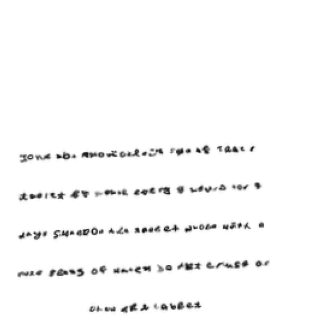

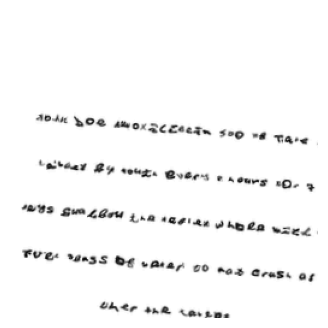

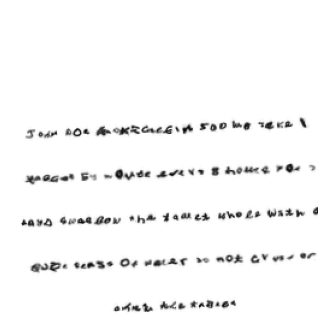

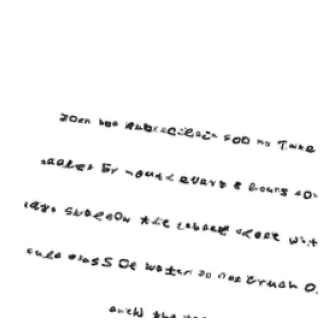

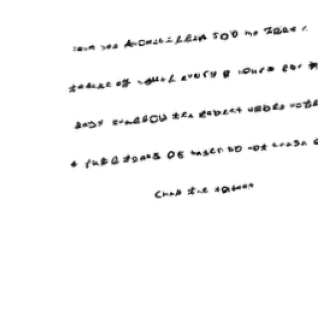

...

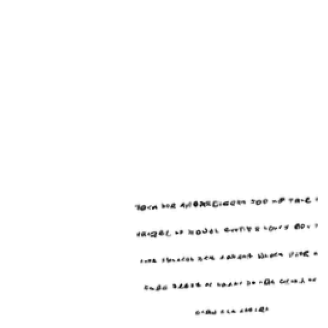

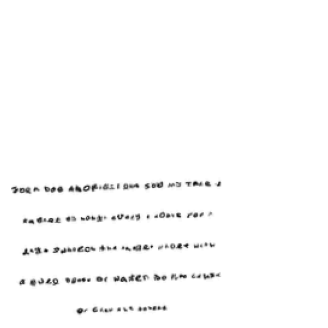

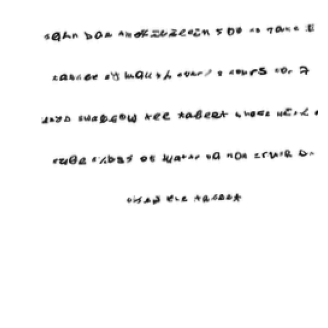

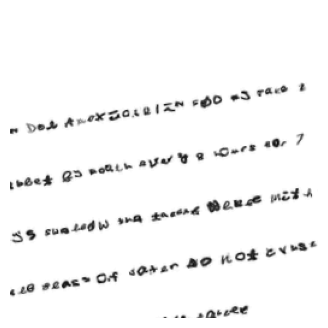

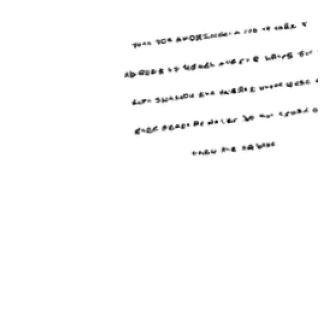

20 synthetic images have been generated and saved.


In [29]:
import os
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from scipy.ndimage import shift as scipy_shift

DATA_PATH = 'data'

with open('label.txt', 'r') as f:
    labels = f.read().splitlines()

label_to_folder = {label: str(i) for i, label in enumerate(labels)}

def load_character_images():
    char_images = {}
    for label, folder in label_to_folder.items():
        folder_path = os.path.join(DATA_PATH, folder)
        images = []
        for img_file in os.listdir(folder_path):
            if img_file.endswith('.png'):
                img_path = os.path.join(folder_path, img_file)
                img = Image.open(img_path).convert('L')  # Convert to grayscale
                images.append(np.array(img))
        char_images[label] = images
    return char_images

def random_rotation(image, max_angle=15):
    angle = random.uniform(-max_angle, max_angle)
    return Image.fromarray(image).rotate(angle, resample=Image.BILINEAR, expand=True)

def random_shift(image, max_shift=1):
    shift_x = random.randint(-max_shift, max_shift)
    shift_y = random.randint(-max_shift, max_shift)
    return scipy_shift(image, (shift_y, shift_x), cval=255)

def scale_image(image, scale_factor):
    h, w = image.shape
    new_h, new_w = int(h * scale_factor), int(w * scale_factor)
    return Image.fromarray(image).resize((new_w, new_h), Image.LANCZOS)

def generate_line(text, char_images, line_height=64, space_width=10):
    line_image = Image.new('L', (1, line_height), color=255)
    
    for char in text:
        if char == ' ':
            space = Image.new('L', (space_width, line_height), color=255)
            new_width = line_image.width + space.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(space, (line_image.width, 0))
            line_image = new_image
        elif char in char_images:
            char_img = random.choice(char_images[char])
            char_img = scale_image(char_img, random.uniform(0.3, 0.6))  # Randomly scale 30%-60%
            char_img = random_rotation(np.array(char_img))
            char_img = random_shift(char_img)
            char_img = Image.fromarray(char_img)
            
            new_width = line_image.width + char_img.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(char_img, (line_image.width, (line_height - char_img.height) // 2), char_img)
            line_image = new_image
        else:
            print(f"Character '{char}' not found in char_images")
    
    return line_image

def join_units(text):
    words = text.split()
    combined_words = []
    
    i = 0
    while i < len(words):
        if words[i].isdigit() and i + 1 < len(words) and words[i + 1] in ['mg', 'ml']:
            combined_words.append(f"{words[i]} {words[i + 1]}")  # Join number and unit
            i += 2  # Skip the next word (mg/ml)
        else:
            combined_words.append(words[i])
            i += 1
    return ' '.join(combined_words)

def generate_multiline_image(text, char_images, max_width=512, line_spacing=10):
    text = join_units(text)  # Ensure 'mg' and 'ml' are joined with the preceding number
    words = text.split()
    lines = []
    current_line = []
    
    for word in words:
        test_line = current_line + [word]
        test_image = generate_line(' '.join(test_line), char_images)
        
        if test_image.width <= max_width:
            current_line.append(word)
        else:
            if current_line:
                lines.append(' '.join(current_line))
                current_line = [word]
            else:
                lines.append(word)
                current_line = []
    
    if current_line:
        lines.append(' '.join(current_line))
    
    # Calculate the maximum line width to ensure no cropping
    line_images = [generate_line(line, char_images) for line in lines]
    max_line_width = max(img.width for img in line_images)
    total_height = sum(img.height for img in line_images) + line_spacing * (len(line_images) - 1)
    
    # Ensure the image width doesn't exceed the max width, with some padding
    target_width = min(max(max_line_width, 256), max_width)
    
    # Create a new multiline image canvas based on calculated dimensions
    multiline_image = Image.new('L', (target_width, total_height), color=255)
    y_offset = 0
    
    for line_img in line_images:
        multiline_image.paste(line_img, ((target_width - line_img.width) // 2, y_offset))
        y_offset += line_img.height + line_spacing
    
    # Resize the multiline image to fit within 30-60% of the canvas
    scale_factor = random.uniform(0.3, 0.6)
    new_width = int(multiline_image.width * scale_factor)
    new_height = int(multiline_image.height * scale_factor)
    resized_image = multiline_image.resize((new_width, new_height), Image.LANCZOS)
    
    # Create the final image canvas and randomly place text on one of four corners with a random rotation
    final_image = Image.new('L', (256, 256), color=255)
    position = random.choice(['top_left', 'top_right', 'bottom_left', 'bottom_right'])
    
    if position == 'top_left':
        paste_position = (0, 0)
    elif position == 'top_right':
        paste_position = (256 - resized_image.width, 0)
    elif position == 'bottom_left':
        paste_position = (0, 256 - resized_image.height)
    else:  # bottom_right
        paste_position = (256 - resized_image.width, 256 - resized_image.height)
    
    # Rotate the resized image by a random angle between -15 and 15 degrees
    rotated_image = resized_image.rotate(random.uniform(-15, 15), resample=Image.BILINEAR, expand=True)
    
    # Paste the rotated image into the final image canvas
    final_image.paste(rotated_image, paste_position, rotated_image)
    
    return final_image

def clean_text(text):
    # Remove dots from the text
    return text.replace('.', '')

# Load character images
char_images = load_character_images()

# Generate synthetic data with new sentence
text = clean_text("John Doe Amoxicillin 500 mg Take 1 tablet by mouth every 8 hours for 7 days Swallow the tablet whole with a full glass of water Do not crush or chew the tablet")
num_images = 20
image_data = []

for i in range(num_images):
    image = generate_multiline_image(text, char_images)
    image_path = f'synthetic_image_{i+1}.png'
    image.save(image_path)
    
    # Prepare the training data in the specified format
    data_entry = {
        "query": "<image>55555",
        "response": text.replace(' ', '\n'),  # Use new lines for the response text
        "images": [image_path]
    }
    image_data.append(data_entry)
    
    plt.figure(figsize=(4, 4))
    plt.imshow(image, cmap='gray')
    plt.axis('off')  # Remove the title
    plt.show()

print(f"{num_images} synthetic images have been generated and saved.")


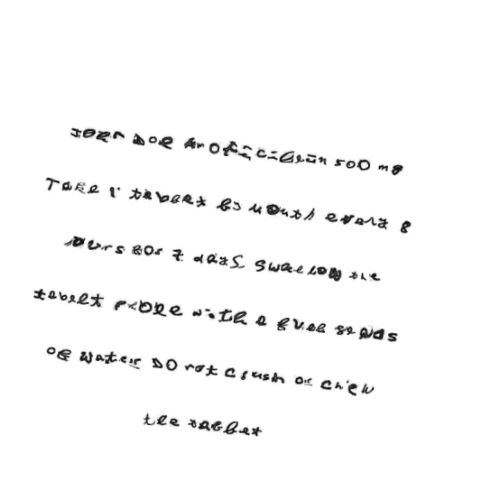

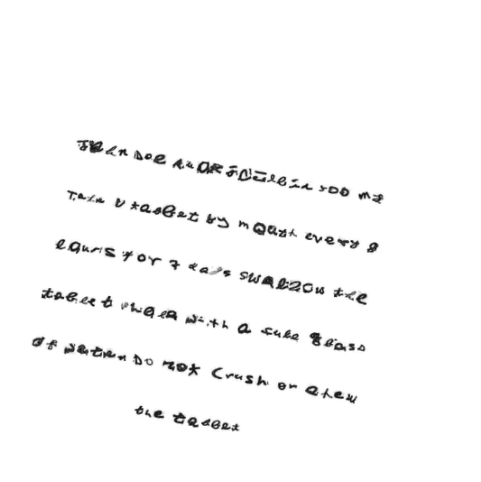

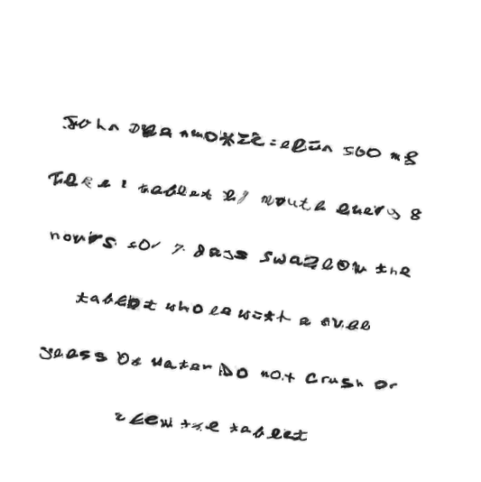

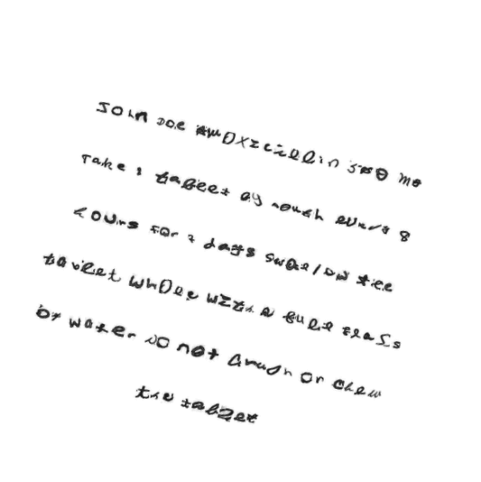

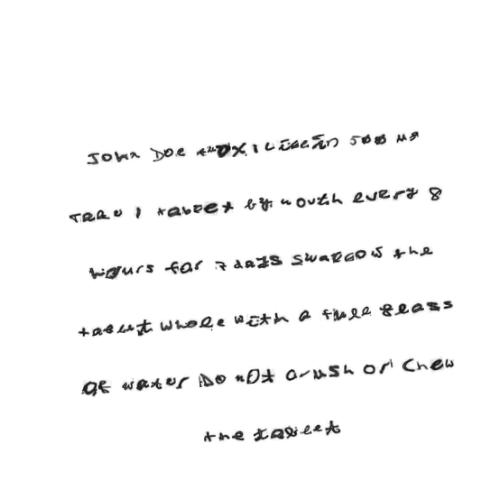

...

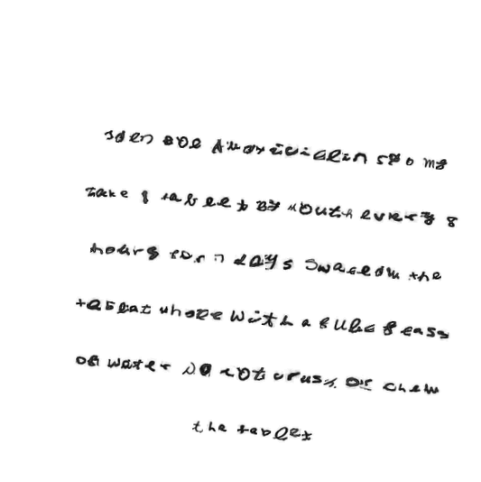

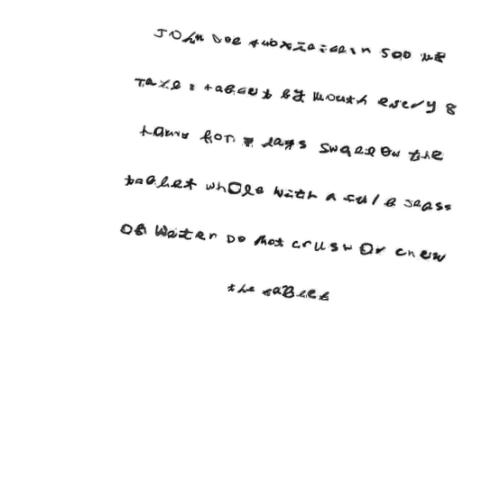

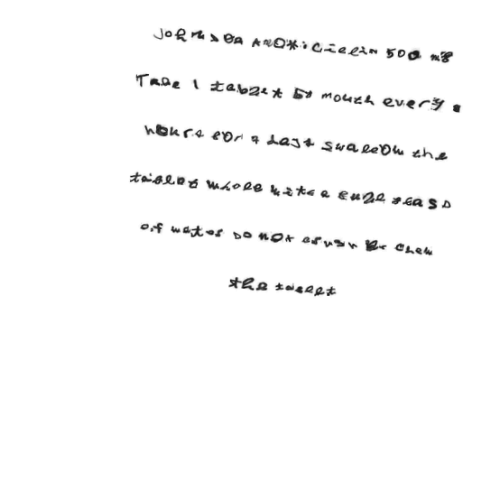

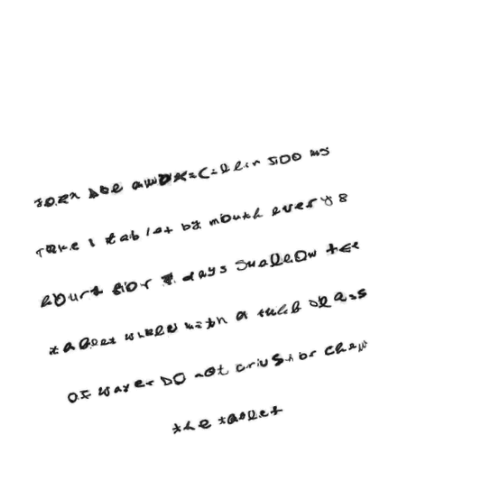

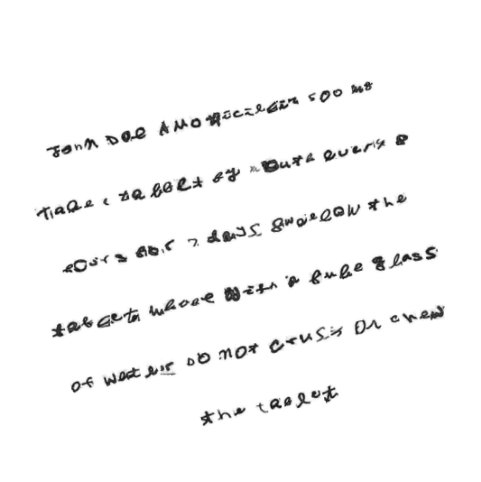

20 synthetic images have been generated and saved.


In [35]:
import os
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from scipy.ndimage import shift as scipy_shift

DATA_PATH = 'data'

with open('label.txt', 'r') as f:
    labels = f.read().splitlines()

label_to_folder = {label: str(i) for i, label in enumerate(labels)}

def load_character_images():
    char_images = {}
    for label, folder in label_to_folder.items():
        folder_path = os.path.join(DATA_PATH, folder)
        images = []
        for img_file in os.listdir(folder_path):
            if img_file.endswith('.png'):
                img_path = os.path.join(folder_path, img_file)
                img = Image.open(img_path).convert('L')  # Convert to grayscale
                images.append(np.array(img))
        char_images[label] = images
    return char_images

def random_rotation(image, max_angle=15):
    angle = random.uniform(-max_angle, max_angle)
    return Image.fromarray(image).rotate(angle, resample=Image.BILINEAR, expand=True)

def random_shift(image, max_shift=1):
    shift_x = random.randint(-max_shift, max_shift)
    shift_y = random.randint(-max_shift, max_shift)
    return scipy_shift(image, (shift_y, shift_x), cval=255)

def scale_image(image, scale_factor):
    h, w = image.shape
    new_h, new_w = int(h * scale_factor), int(w * scale_factor)
    return Image.fromarray(image).resize((new_w, new_h), Image.LANCZOS)

def generate_line(text, char_images, line_height=64, space_width=10):
    line_image = Image.new('L', (1, line_height), color=255)
    
    for char in text:
        if char == ' ':
            space = Image.new('L', (space_width, line_height), color=255)
            new_width = line_image.width + space.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(space, (line_image.width, 0))
            line_image = new_image
        elif char in char_images:
            char_img = random.choice(char_images[char])
            char_img = scale_image(char_img, random.uniform(0.4, 0.7))  # Randomly scale 30%-60%
            char_img = random_rotation(np.array(char_img))
            char_img = random_shift(char_img)
            char_img = Image.fromarray(char_img)
            
            new_width = line_image.width + char_img.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(char_img, (line_image.width, (line_height - char_img.height) // 2), char_img)
            line_image = new_image
        else:
            print(f"Character '{char}' not found in char_images")
    
    return line_image

def join_units(text):
    words = text.split()
    combined_words = []
    
    i = 0
    while i < len(words):
        if words[i].isdigit() and i + 1 < len(words) and words[i + 1] in ['mg', 'ml']:
            combined_words.append(f"{words[i]} {words[i + 1]}")  # Join number and unit
            i += 2  # Skip the next word (mg/ml)
        else:
            combined_words.append(words[i])
            i += 1
    return ' '.join(combined_words)

def generate_multiline_image(text, char_images, max_width=512, line_spacing=10, canvas_size=512):
    text = join_units(text)  # Ensure 'mg' and 'ml' are joined with the preceding number
    words = text.split()
    lines = []
    current_line = []
    
    for word in words:
        test_line = current_line + [word]
        test_image = generate_line(' '.join(test_line), char_images)
        
        if test_image.width <= max_width:
            current_line.append(word)
        else:
            if current_line:
                lines.append(' '.join(current_line))
                current_line = [word]
            else:
                lines.append(word)
                current_line = []
    
    if current_line:
        lines.append(' '.join(current_line))
    
    # Calculate the maximum line width to ensure no cropping
    line_images = [generate_line(line, char_images) for line in lines]
    max_line_width = max(img.width for img in line_images)
    total_height = sum(img.height for img in line_images) + line_spacing * (len(line_images) - 1)
    
    # Ensure the image width doesn't exceed the max width, with some padding
    target_width = min(max(max_line_width, canvas_size), max_width)
    
    # Create a new multiline image canvas based on calculated dimensions
    multiline_image = Image.new('L', (target_width, total_height), color=255)
    y_offset = 0
    
    for line_img in line_images:
        multiline_image.paste(line_img, ((target_width - line_img.width) // 2, y_offset))
        y_offset += line_img.height + line_spacing
    
    # Resize the multiline image to fit within 30-60% of the canvas
    scale_factor = random.uniform(0.7, 0.9)
    new_width = int(multiline_image.width * scale_factor)
    new_height = int(multiline_image.height * scale_factor)
    resized_image = multiline_image.resize((new_width, new_height), Image.LANCZOS)
    
    # Create the final image canvas and randomly place text on one of four corners with a random rotation
    final_image = Image.new('L', (canvas_size, canvas_size), color=255)
    position = random.choice(['top_left', 'top_right', 'bottom_left', 'bottom_right'])
    
    if position == 'top_left':
        paste_position = (0, 0)
    elif position == 'top_right':
        paste_position = (canvas_size - resized_image.width, 0)
    elif position == 'bottom_left':
        paste_position = (0, canvas_size - resized_image.height)
    else:  # bottom_right
        paste_position = (canvas_size - resized_image.width, canvas_size - resized_image.height)
    
    # Rotate the resized image by a random angle between -15 and 15 degrees
    rotated_image = resized_image.rotate(random.uniform(-15, 15), resample=Image.BILINEAR, expand=True)
    
    # Ensure no cropping happens by adjusting the paste position if rotated image exceeds canvas bounds
    rotated_w, rotated_h = rotated_image.size
    if paste_position[0] + rotated_w > canvas_size:
        paste_position = (canvas_size - rotated_w, paste_position[1])
    if paste_position[1] + rotated_h > canvas_size:
        paste_position = (paste_position[0], canvas_size - rotated_h)
    
    # Paste the rotated image into the final image canvas
    final_image.paste(rotated_image, paste_position, rotated_image)
    
    return final_image

def clean_text(text):
    # Remove dots from the text
    return text.replace('.', '')

# Load character images
char_images = load_character_images()

# Generate synthetic data with new sentence
text = clean_text("John Doe Amoxicillin 500 mg Take 1 tablet by mouth every 8 hours for 7 days Swallow the tablet whole with a full glass of water Do not crush or chew the tablet")
num_images = 20
image_data = []

# Increase canvas size to reduce blur and avoid cropping
canvas_size = 512  # Change from 256 to 512

for i in range(num_images):
    image = generate_multiline_image(text, char_images, canvas_size=canvas_size)
    image_path = f'synthetic_image_{i+1}.png'
    image.save(image_path)
    
    # Prepare the training data in the specified format
    data_entry = {
        "query": "<image>55555",
        "response": text.replace(' ', '\n'),  # Use new lines for the response text
        "images": [image_path]
    }
    image_data.append(data_entry)
    
    plt.figure(figsize=(6, 6))  # Display larger image to reduce blurriness
    plt.imshow(image, cmap='gray')
    plt.axis('off')  # Remove the title
    plt.show()

print(f"{num_images} synthetic images have been generated and saved.")


C:\Users\alexg\AppData\Local\Temp\ipykernel_68392\2135533532.py:146: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed in 3.10. Use buffer_rgba instead.
  data = np.frombuffer(fig.canvas.tostring_rgb(), dtype=np.uint8)


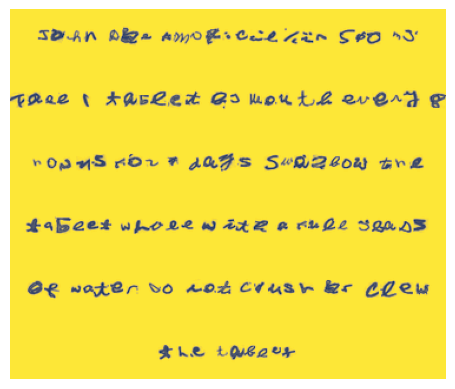

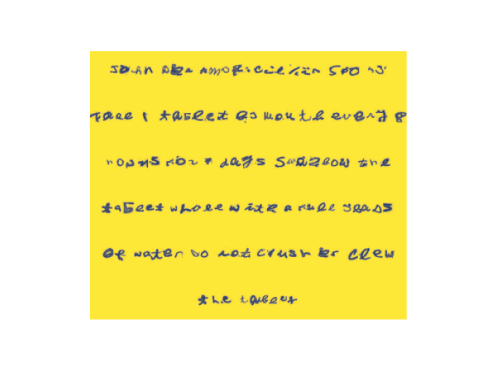

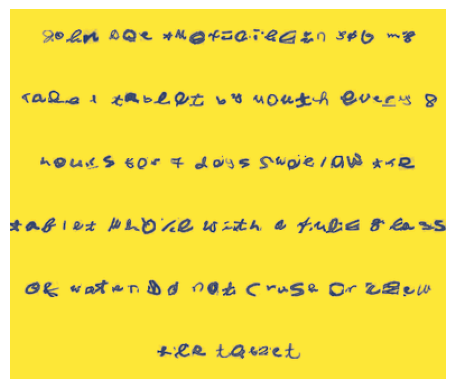

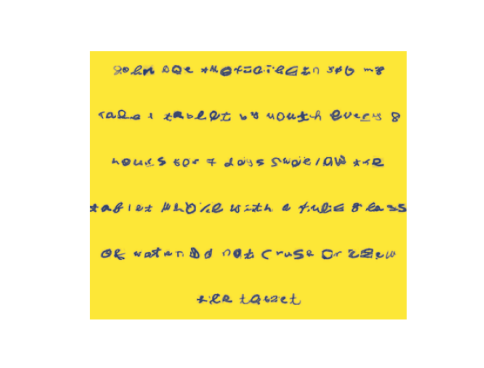

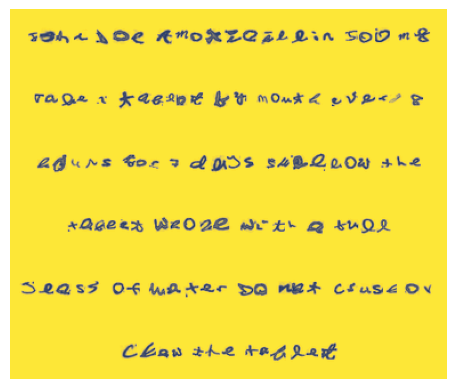

...

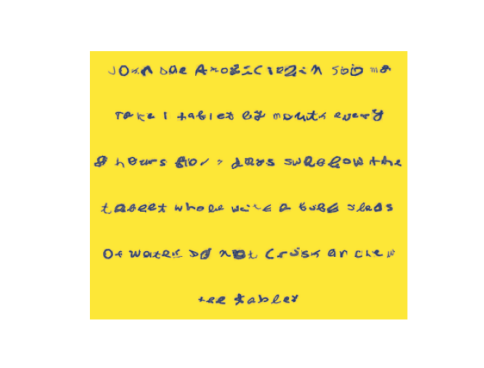

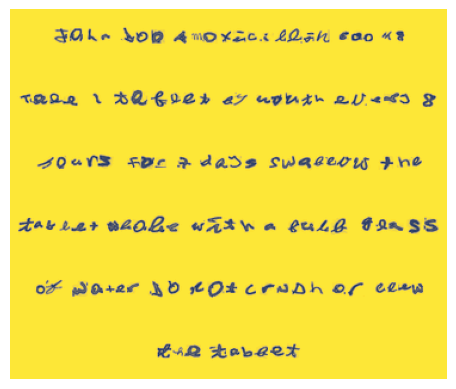

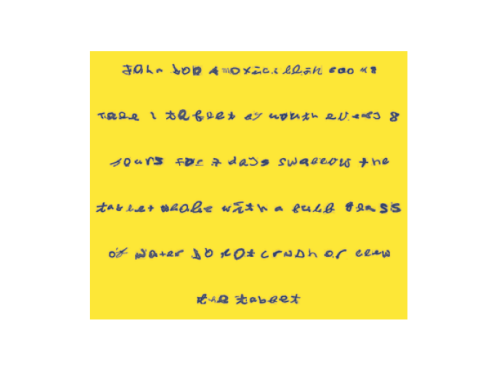

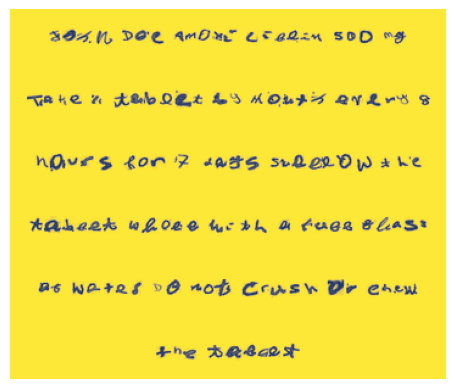

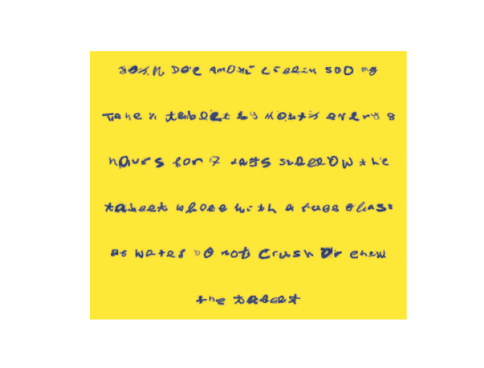

120 synthetic images with different colormaps have been generated and saved in dataset.


In [36]:
import os
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from scipy.ndimage import shift as scipy_shift
import json

DATA_PATH = 'data'
OUTPUT_PATH = 'dataset'

# Ensure the dataset directory exists
if not os.path.exists(OUTPUT_PATH):
    os.makedirs(OUTPUT_PATH)

# Load labels from label.txt
with open('label.txt', 'r') as f:
    labels = f.read().splitlines()

label_to_folder = {label: str(i) for i, label in enumerate(labels)}

def load_character_images():
    char_images = {}
    for label, folder in label_to_folder.items():
        folder_path = os.path.join(DATA_PATH, folder)
        images = []
        for img_file in os.listdir(folder_path):
            if img_file.endswith('.png'):
                img_path = os.path.join(folder_path, img_file)
                img = Image.open(img_path).convert('L')  # Convert to grayscale
                images.append(np.array(img))
        char_images[label] = images
    return char_images

def random_rotation(image, max_angle=15):
    angle = random.uniform(-max_angle, max_angle)
    return Image.fromarray(image).rotate(angle, resample=Image.BILINEAR, expand=True)

def random_shift(image, max_shift=1):
    shift_x = random.randint(-max_shift, max_shift)
    shift_y = random.randint(-max_shift, max_shift)
    return scipy_shift(image, (shift_y, shift_x), cval=255)

def scale_image(image, scale_factor):
    h, w = image.shape
    new_h, new_w = int(h * scale_factor), int(w * scale_factor)
    return Image.fromarray(image).resize((new_w, new_h), Image.LANCZOS)

def generate_line(text, char_images, line_height=64, space_width=10):
    line_image = Image.new('L', (1, line_height), color=255)
    
    for char in text:
        if char == ' ':
            space = Image.new('L', (space_width, line_height), color=255)
            new_width = line_image.width + space.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(space, (line_image.width, 0))
            line_image = new_image
        elif char in char_images:
            char_img = random.choice(char_images[char])
            char_img = scale_image(char_img, random.uniform(0.4, 0.7))  # Randomly scale 30%-60%
            char_img = random_rotation(np.array(char_img))
            char_img = random_shift(char_img)
            char_img = Image.fromarray(char_img)
            
            new_width = line_image.width + char_img.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(char_img, (line_image.width, (line_height - char_img.height) // 2), char_img)
            line_image = new_image
        else:
            print(f"Character '{char}' not found in char_images")
    
    return line_image

def join_units(text):
    words = text.split()
    combined_words = []
    
    i = 0
    while i < len(words):
        if words[i].isdigit() and i + 1 < len(words) and words[i + 1] in ['mg', 'ml']:
            combined_words.append(f"{words[i]} {words[i + 1]}")  # Join number and unit
            i += 2  # Skip the next word (mg/ml)
        else:
            combined_words.append(words[i])
            i += 1
    return ' '.join(combined_words)

def generate_multiline_image(text, char_images, max_width=512, line_spacing=10, canvas_size=512):
    text = join_units(text)  # Ensure 'mg' and 'ml' are joined with the preceding number
    words = text.split()
    lines = []
    current_line = []
    
    for word in words:
        test_line = current_line + [word]
        test_image = generate_line(' '.join(test_line), char_images)
        
        if test_image.width <= max_width:
            current_line.append(word)
        else:
            if current_line:
                lines.append(' '.join(current_line))
                current_line = [word]
            else:
                lines.append(word)
                current_line = []
    
    if current_line:
        lines.append(' '.join(current_line))
    
    # Calculate the maximum line width to ensure no cropping
    line_images = [generate_line(line, char_images) for line in lines]
    max_line_width = max(img.width for img in line_images)
    total_height = sum(img.height for img in line_images) + line_spacing * (len(line_images) - 1)
    
    # Ensure the image width doesn't exceed the max width, with some padding
    target_width = min(max(max_line_width, canvas_size), max_width)
    
    # Create a new multiline image canvas based on calculated dimensions
    multiline_image = Image.new('L', (target_width, total_height), color=255)
    y_offset = 0
    
    for line_img in line_images:
        multiline_image.paste(line_img, ((target_width - line_img.width) // 2, y_offset))
        y_offset += line_img.height + line_spacing
    
    # Resize the multiline image to fit within 30-60% of the canvas
    scale_factor = random.uniform(0.7, 0.9)
    new_width = int(multiline_image.width * scale_factor)
    new_height = int(multiline_image.height * scale_factor)
    resized_image = multiline_image.resize((new_width, new_height), Image.LANCZOS)
    
    return resized_image

def apply_color_map(image, cmap_name):
    plt_image = plt.imshow(image, cmap=cmap_name)
    plt.axis('off')  # Hide axis
    plt.draw()

    # Convert plt image to numpy array and then to PIL Image
    fig = plt.gcf()
    fig.canvas.draw()
    data = np.frombuffer(fig.canvas.tostring_rgb(), dtype=np.uint8)
    data = data.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    plt_image_pil = Image.fromarray(data)

    return plt_image_pil

def clean_text(text):
    # Remove dots from the text
    return text.replace('.', '')

# Load character images
char_images = load_character_images()

# Generate synthetic data with new sentence
text = clean_text("John Doe Amoxicillin 500 mg Take 1 tablet by mouth every 8 hours for 7 days Swallow the tablet whole with a full glass of water Do not crush or chew the tablet")
num_images = 20
image_data = []
canvas_size = 512  # Increased canvas size

cmaps = ['gray', 'viridis', 'plasma', 'inferno', 'magma', 'cividis']  # Different colormaps

for i in range(num_images):
    image = generate_multiline_image(text, char_images, canvas_size=canvas_size)
    
    # Apply color maps
    for cmap in cmaps:
        colored_image = apply_color_map(np.array(image), cmap)
        
        image_path = os.path.join(OUTPUT_PATH, f'synthetic_image_{i+1}_{cmap}.png')
        colored_image.save(image_path)
        
        # Prepare the training data in the specified format
        data_entry = {
            "query": "<image>what does this say?",
            "response": text.replace(' ', '\n'),  # Use new lines for the response text
            "images": [image_path]
        }
        image_data.append(data_entry)

    plt.figure(figsize=(6, 6))
    plt.imshow(colored_image)
    plt.axis('off')
    plt.show()

# Save dataset to JSON file
json_path = os.path.join(OUTPUT_PATH, 'dataset.json')
with open(json_path, 'w') as f:
    json.dump(image_data, f, indent=4)

print(f"{num_images * len(cmaps)} synthetic images with different colormaps have been generated and saved in {OUTPUT_PATH}.")


C:\Users\alexg\AppData\Local\Temp\ipykernel_68392\1756017121.py:146: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed in 3.10. Use buffer_rgba instead.
  data = np.frombuffer(fig.canvas.tostring_rgb(), dtype=np.uint8)


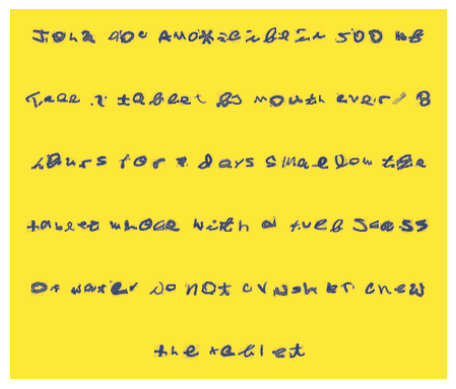

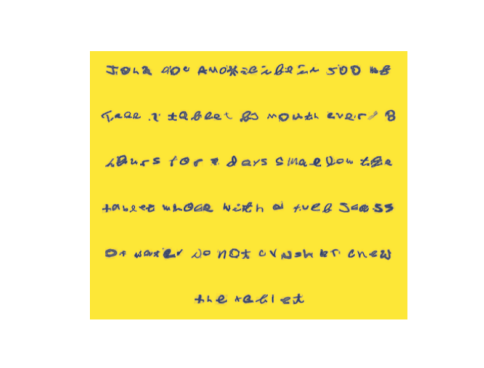

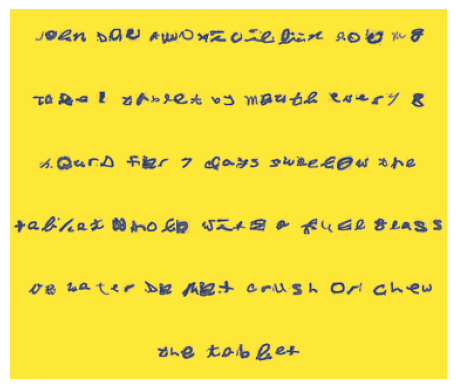

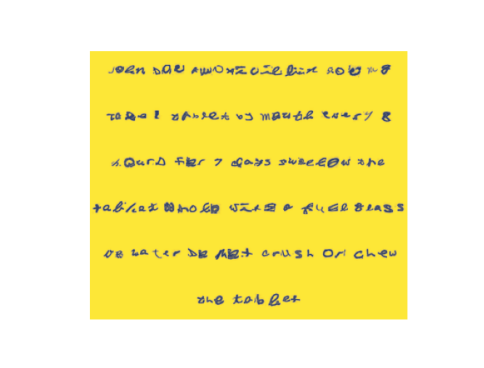

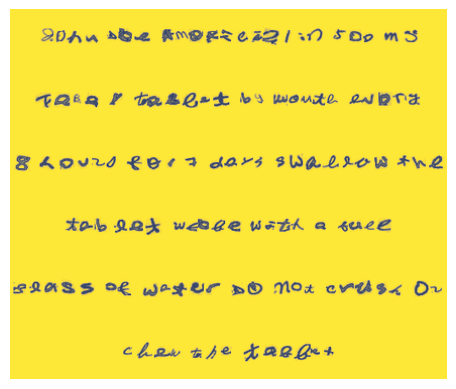

...

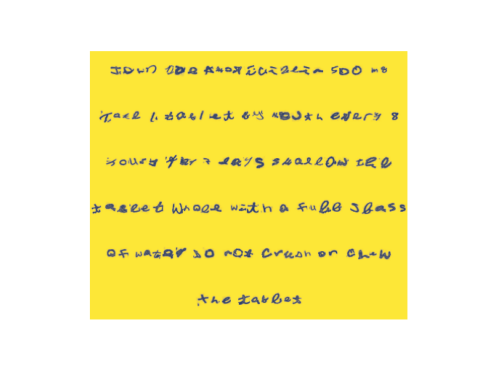

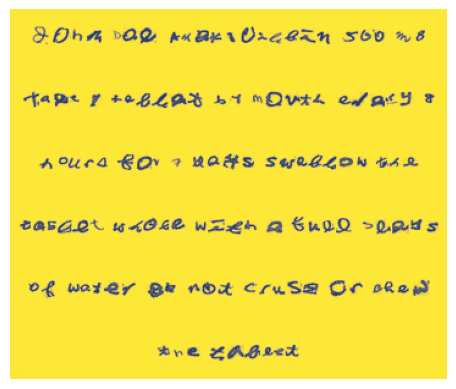

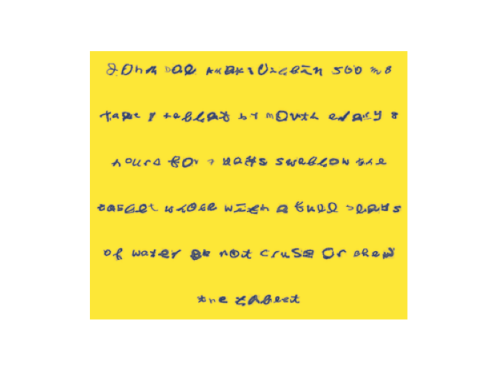

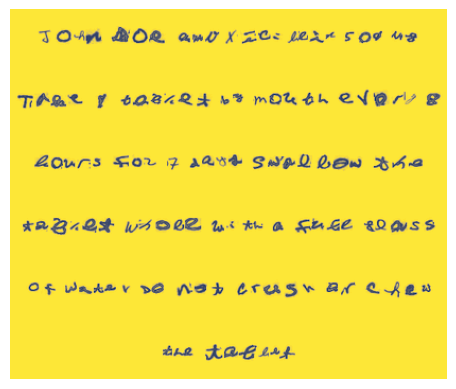

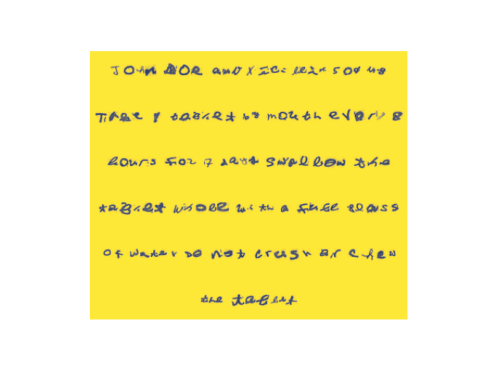

120 synthetic images with different colormaps have been generated and saved in dataset.


In [37]:
import os
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from scipy.ndimage import shift as scipy_shift
import json

DATA_PATH = 'data'
OUTPUT_PATH = 'dataset'

# Ensure the dataset directory exists
if not os.path.exists(OUTPUT_PATH):
    os.makedirs(OUTPUT_PATH)

# Load labels from label.txt
with open('label.txt', 'r') as f:
    labels = f.read().splitlines()

label_to_folder = {label: str(i) for i, label in enumerate(labels)}

def load_character_images():
    char_images = {}
    for label, folder in label_to_folder.items():
        folder_path = os.path.join(DATA_PATH, folder)
        images = []
        for img_file in os.listdir(folder_path):
            if img_file.endswith('.png'):
                img_path = os.path.join(folder_path, img_file)
                img = Image.open(img_path).convert('L')  # Convert to grayscale
                images.append(np.array(img))
        char_images[label] = images
    return char_images

def random_rotation(image, max_angle=15):
    angle = random.uniform(-max_angle, max_angle)
    return Image.fromarray(image).rotate(angle, resample=Image.BILINEAR, expand=True)

def random_shift(image, max_shift=1):
    shift_x = random.randint(-max_shift, max_shift)
    shift_y = random.randint(-max_shift, max_shift)
    return scipy_shift(image, (shift_y, shift_x), cval=255)

def scale_image(image, scale_factor):
    h, w = image.shape
    new_h, new_w = int(h * scale_factor), int(w * scale_factor)
    return Image.fromarray(image).resize((new_w, new_h), Image.LANCZOS)

def generate_line(text, char_images, line_height=64, space_width=10):
    line_image = Image.new('L', (1, line_height), color=255)
    
    for char in text:
        if char == ' ':
            space = Image.new('L', (space_width, line_height), color=255)
            new_width = line_image.width + space.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(space, (line_image.width, 0))
            line_image = new_image
        elif char in char_images:
            char_img = random.choice(char_images[char])
            char_img = scale_image(char_img, random.uniform(0.4, 0.7))  # Randomly scale 30%-60%
            char_img = random_rotation(np.array(char_img))
            char_img = random_shift(char_img)
            char_img = Image.fromarray(char_img)
            
            new_width = line_image.width + char_img.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(char_img, (line_image.width, (line_height - char_img.height) // 2), char_img)
            line_image = new_image
        else:
            print(f"Character '{char}' not found in char_images")
    
    return line_image

def join_units(text):
    words = text.split()
    combined_words = []
    
    i = 0
    while i < len(words):
        if words[i].isdigit() and i + 1 < len(words) and words[i + 1] in ['mg', 'ml']:
            combined_words.append(f"{words[i]} {words[i + 1]}")  # Join number and unit
            i += 2  # Skip the next word (mg/ml)
        else:
            combined_words.append(words[i])
            i += 1
    return ' '.join(combined_words)

def generate_multiline_image(text, char_images, max_width=512, line_spacing=10, canvas_size=512):
    text = join_units(text)  # Ensure 'mg' and 'ml' are joined with the preceding number
    words = text.split()
    lines = []
    current_line = []
    
    for word in words:
        test_line = current_line + [word]
        test_image = generate_line(' '.join(test_line), char_images)
        
        if test_image.width <= max_width:
            current_line.append(word)
        else:
            if current_line:
                lines.append(' '.join(current_line))
                current_line = [word]
            else:
                lines.append(word)
                current_line = []
    
    if current_line:
        lines.append(' '.join(current_line))
    
    # Calculate the maximum line width to ensure no cropping
    line_images = [generate_line(line, char_images) for line in lines]
    max_line_width = max(img.width for img in line_images)
    total_height = sum(img.height for img in line_images) + line_spacing * (len(line_images) - 1)
    
    # Ensure the image width doesn't exceed the max width, with some padding
    target_width = min(max(max_line_width, canvas_size), max_width)
    
    # Create a new multiline image canvas based on calculated dimensions
    multiline_image = Image.new('L', (target_width, total_height), color=255)
    y_offset = 0
    
    for line_img in line_images:
        multiline_image.paste(line_img, ((target_width - line_img.width) // 2, y_offset))
        y_offset += line_img.height + line_spacing
    
    # Resize the multiline image to fit within 30-60% of the canvas
    scale_factor = random.uniform(0.7, 0.9)
    new_width = int(multiline_image.width * scale_factor)
    new_height = int(multiline_image.height * scale_factor)
    resized_image = multiline_image.resize((new_width, new_height), Image.LANCZOS)
    
    return resized_image

def apply_color_map(image, cmap_name):
    plt_image = plt.imshow(image, cmap=cmap_name)
    plt.axis('off')  # Hide axis
    plt.draw()

    # Convert plt image to numpy array and then to PIL Image
    fig = plt.gcf()
    fig.canvas.draw()
    data = np.frombuffer(fig.canvas.tostring_rgb(), dtype=np.uint8)
    data = data.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    plt_image_pil = Image.fromarray(data)

    return plt_image_pil

def clean_text(text):
    # Remove dots from the text
    return text.replace('.', '')

# Load character images
char_images = load_character_images()

# Generate synthetic data with new sentence
text = clean_text("John Doe Amoxicillin 500 mg Take 1 tablet by mouth every 8 hours for 7 days Swallow the tablet whole with a full glass of water Do not crush or chew the tablet")
num_images = 20
image_data = []
canvas_size = 512  # Increased canvas size

cmaps = ['gray', 'viridis', 'plasma', 'inferno', 'magma', 'cividis']  # Different colormaps

for i in range(num_images):
    image = generate_multiline_image(text, char_images, canvas_size=canvas_size)
    
    # Apply color maps
    for cmap in cmaps:
        colored_image = apply_color_map(np.array(image), cmap)
        
        image_path = os.path.join(OUTPUT_PATH, f'synthetic_image_{i+1}_{cmap}.png').replace('\\', '/')
        colored_image.save(image_path)
        
        # Prepare the training data in the specified format
        response_text = text  # Adjust the response based on how the image is formatted
        data_entry = {
            "query": "<image>what does this say?",
            "response": response_text,
            "images": [image_path]
        }
        image_data.append(data_entry)

    plt.figure(figsize=(6, 6))
    plt.imshow(colored_image)
    plt.axis('off')
    plt.show()

# Save dataset to JSON file in the root directory
json_path = 'dataset.json'
with open(json_path, 'w') as f:
    json.dump(image_data, f, indent=4)

print(f"{num_images * len(cmaps)} synthetic images with different colormaps have been generated and saved in {OUTPUT_PATH}.")


C:\Users\alexg\AppData\Local\Temp\ipykernel_68392\3743913703.py:142: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed in 3.10. Use buffer_rgba instead.
  data = np.frombuffer(fig.canvas.tostring_rgb(), dtype=np.uint8)


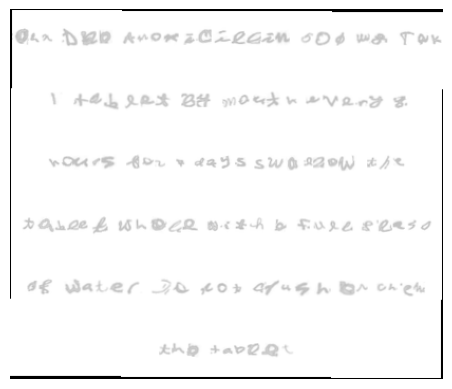

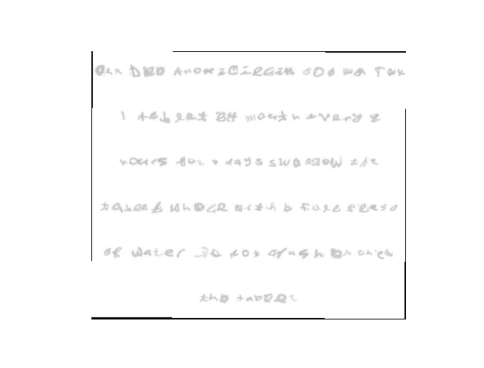

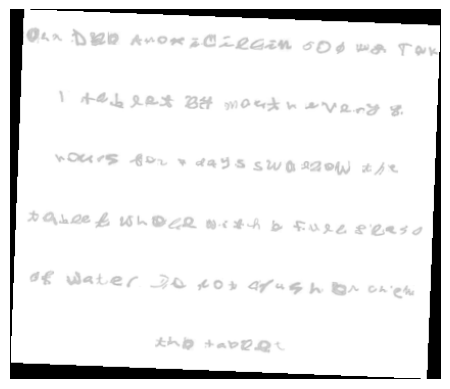

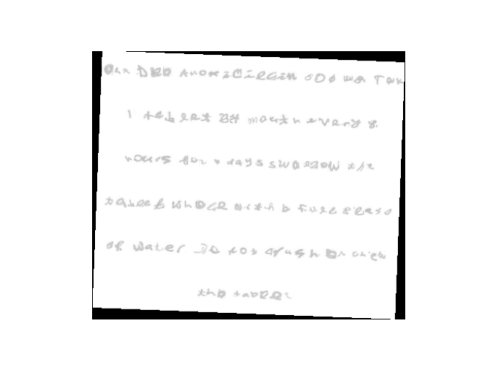

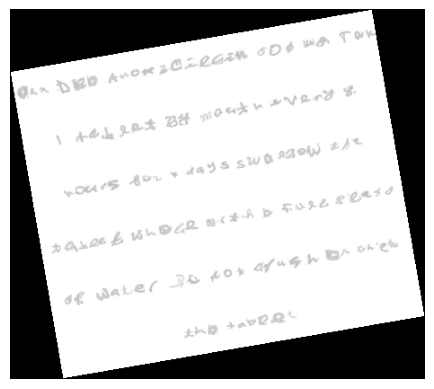

...

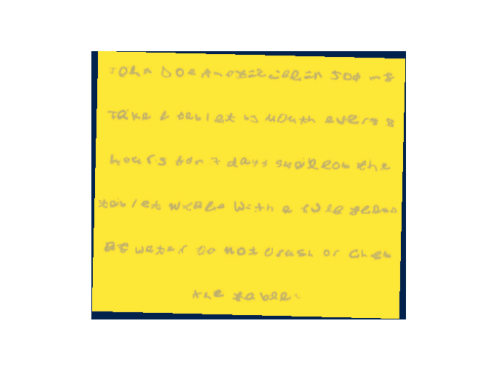

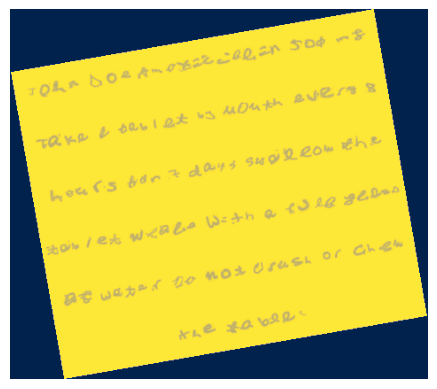

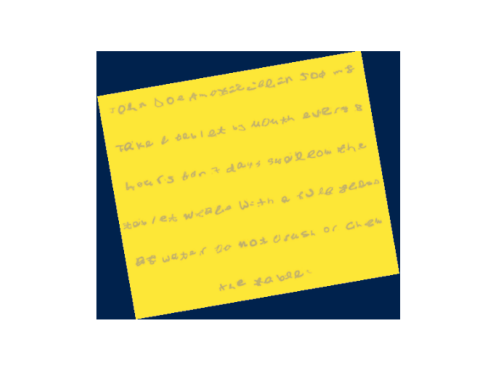

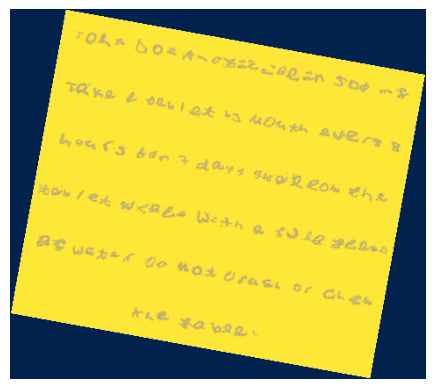

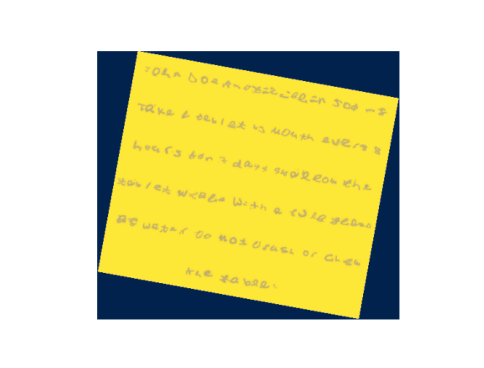

KeyboardInterrupt: 

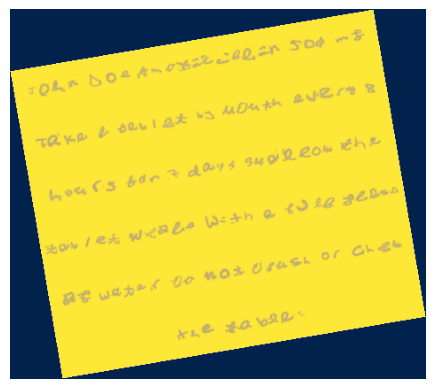

In [38]:
import os
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from scipy.ndimage import shift as scipy_shift
import json

DATA_PATH = 'data'
OUTPUT_PATH = 'dataset'

# Ensure the dataset directory exists
if not os.path.exists(OUTPUT_PATH):
    os.makedirs(OUTPUT_PATH)

# Load labels from label.txt
with open('label.txt', 'r') as f:
    labels = f.read().splitlines()

label_to_folder = {label: str(i) for i, label in enumerate(labels)}

def load_character_images():
    char_images = {}
    for label, folder in label_to_folder.items():
        folder_path = os.path.join(DATA_PATH, folder)
        images = []
        for img_file in os.listdir(folder_path):
            if img_file.endswith('.png'):
                img_path = os.path.join(folder_path, img_file)
                img = Image.open(img_path).convert('L')  # Convert to grayscale
                images.append(np.array(img))
        char_images[label] = images
    return char_images

def random_rotation(image, max_angle=15):
    angle = random.uniform(-max_angle, max_angle)
    return Image.fromarray(image).rotate(angle, resample=Image.BILINEAR, expand=True), angle

def random_shift(image, max_shift=1):
    shift_x = random.randint(-max_shift, max_shift)
    shift_y = random.randint(-max_shift, max_shift)
    return scipy_shift(image, (shift_y, shift_x), cval=255)

def scale_image(image, scale_factor):
    h, w = image.shape
    new_h, new_w = int(h * scale_factor), int(w * scale_factor)
    return Image.fromarray(image).resize((new_w, new_h), Image.LANCZOS)

def generate_line(text, char_images, line_height=64, space_width=10):
    line_image = Image.new('L', (1, line_height), color=255)
    
    for char in text:
        if char == ' ':
            space = Image.new('L', (space_width, line_height), color=255)
            new_width = line_image.width + space.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(space, (line_image.width, 0))
            line_image = new_image
        elif char in char_images:
            char_img = random.choice(char_images[char])
            char_img = scale_image(char_img, random.uniform(0.4, 0.7))  # Randomly scale 30%-60%
            char_img = random_rotation(np.array(char_img))[0]
            char_img = random_shift(char_img)
            char_img = Image.fromarray(char_img)
            
            new_width = line_image.width + char_img.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(char_img, (line_image.width, (line_height - char_img.height) // 2), char_img)
            line_image = new_image
        else:
            print(f"Character '{char}' not found in char_images")
    
    return line_image

def join_units(text):
    words = text.split()
    combined_words = []
    
    i = 0
    while i < len(words):
        if words[i].isdigit() and i + 1 < len(words) and words[i + 1] in ['mg', 'ml']:
            combined_words.append(f"{words[i]} {words[i + 1]}")  # Join number and unit
            i += 2  # Skip the next word (mg/ml)
        else:
            combined_words.append(words[i])
            i += 1
    return ' '.join(combined_words)

def generate_multiline_image(text, char_images, max_width=512, line_spacing=10, canvas_size=512):
    text = join_units(text)
    words = text.split()
    lines = []
    current_line = []
    
    for word in words:
        test_line = current_line + [word]
        test_image = generate_line(' '.join(test_line), char_images)
        
        if test_image.width <= max_width:
            current_line.append(word)
        else:
            if current_line:
                lines.append(' '.join(current_line))
                current_line = [word]
            else:
                lines.append(word)
                current_line = []
    
    if current_line:
        lines.append(' '.join(current_line))
    
    # Generate the multiline image
    line_images = [generate_line(line, char_images) for line in lines]
    max_line_width = max(img.width for img in line_images)
    total_height = sum(img.height for img in line_images) + line_spacing * (len(line_images) - 1)
    target_width = min(max(max_line_width, canvas_size), max_width)
    
    multiline_image = Image.new('L', (target_width, total_height), color=255)
    y_offset = 0
    
    for line_img in line_images:
        multiline_image.paste(line_img, ((target_width - line_img.width) // 2, y_offset))
        y_offset += line_img.height + line_spacing
    
    # Resize the multiline image to fit within 70-90% of the canvas
    scale_factor = random.uniform(0.7, 0.9)
    resized_image = multiline_image.resize(
        (int(multiline_image.width * scale_factor), int(multiline_image.height * scale_factor)), Image.LANCZOS
    )

    return resized_image, lines  # Return both the final image and the text representation

def apply_color_map(image, cmap_name):
    plt_image = plt.imshow(image, cmap=cmap_name)
    plt.axis('off')  # Hide axis
    plt.draw()

    fig = plt.gcf()
    fig.canvas.draw()
    data = np.frombuffer(fig.canvas.tostring_rgb(), dtype=np.uint8)
    data = data.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    plt_image_pil = Image.fromarray(data)

    return plt_image_pil

def clean_text(text):
    # Remove dots from the text
    return text.replace('.', '')

# Load character images
char_images = load_character_images()

# Synthetic data generation parameters
text = clean_text("John Doe Amoxicillin 500 mg Take 1 tablet by mouth every 8 hours for 7 days Swallow the tablet whole with a full glass of water Do not crush or chew the tablet")
num_images = 10  # Generating 10 different text splits and rotations
cmaps = ['gray', 'viridis', 'plasma', 'inferno', 'magma', 'cividis']  # Different colormaps
canvas_size = 512  # Increased canvas size

image_data = []

for i in range(num_images):
    image, text_representation = generate_multiline_image(text, char_images, canvas_size=canvas_size)
    
    for cmap in cmaps:
        for rotation_idx in range(10):  # Apply 10 different rotations
            # Rotate the image by a random angle between -15 and 15 degrees
            rotated_image, angle = random_rotation(np.array(image))
            
            # Create the final image with different colormap and rotation
            colored_image = apply_color_map(rotated_image, cmap)
            
            # Generate unique file name
            image_filename = f"synthetic_image_{i+1}_{cmap}_rot{rotation_idx}.png"
            image_path = os.path.join(OUTPUT_PATH, image_filename).replace('\\', '/')
            colored_image.save(image_path)
            
            # Prepare the training data in the specified format
            data_entry = {
                "query": "<image>what does this say?",
                "response": '\n'.join(text_representation),  # Text with newline splits
                "images": [image_path]
            }
            image_data.append(data_entry)
            
            plt.figure(figsize=(6, 6))
            plt.imshow(colored_image)
            plt.axis('off')
            plt.show()

# Save dataset to JSON file in the root directory
json_path = 'dataset.json'
with open(json_path, 'w') as f:
    json.dump(image_data, f, indent=4)

print(f"{num_images * len(cmaps) * 10} synthetic images with different colormaps, rotations, and text splits have been generated and saved in {OUTPUT_PATH}.")


In [45]:
import os
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from scipy.ndimage import shift as scipy_shift
import json

DATA_PATH = 'data'
OUTPUT_PATH = 'dataset_uncropped'

# Ensure the dataset directory exists
if not os.path.exists(OUTPUT_PATH):
    os.makedirs(OUTPUT_PATH)

# Load labels from label.txt
with open('label.txt', 'r') as f:
    labels = f.read().splitlines()

label_to_folder = {label: str(i) for i, label in enumerate(labels)}

def load_character_images():
    char_images = {}
    for label, folder in label_to_folder.items():
        folder_path = os.path.join(DATA_PATH, folder)
        images = []
        for img_file in os.listdir(folder_path):
            if img_file.endswith('.png'):
                img_path = os.path.join(folder_path, img_file)
                img = Image.open(img_path).convert('L')  # Convert to grayscale
                images.append(np.array(img))
        char_images[label] = images
    return char_images

def random_rotation(image, max_angle=15):
    angle = random.uniform(-max_angle, max_angle)
    return Image.fromarray(image).rotate(angle, resample=Image.BILINEAR, expand=True), angle

def random_shift(image, max_shift=1):
    shift_x = random.randint(-max_shift, max_shift)
    shift_y = random.randint(-max_shift, max_shift)
    return scipy_shift(image, (shift_y, shift_x), cval=255)

def scale_image(image, scale_factor):
    h, w = image.shape
    new_h, new_w = int(h * scale_factor), int(w * scale_factor)
    return Image.fromarray(image).resize((new_w, new_h), Image.LANCZOS)

def generate_line(text, char_images, line_height=64, space_width=10):
    # Add padding around characters to prevent cropping
    line_image = Image.new('L', (1, line_height), color=255)
    
    for char in text:
        if char == ' ':
            space = Image.new('L', (space_width, line_height), color=255)
            new_width = line_image.width + space.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(space, (line_image.width, 0))
            line_image = new_image
        elif char in char_images:
            char_img = random.choice(char_images[char])
            char_img = scale_image(char_img, random.uniform(0.4, 0.7))  # Randomly scale 30%-60%
            char_img = random_rotation(np.array(char_img))[0]
            char_img = random_shift(char_img)
            char_img = Image.fromarray(char_img)
            
            # Add padding to avoid cropping
            padded_char_img = Image.new('L', (char_img.width + 10, char_img.height + 10), color=255)
            padded_char_img.paste(char_img, (5, 5))
            
            new_width = line_image.width + padded_char_img.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(padded_char_img, (line_image.width, (line_height - padded_char_img.height) // 2), padded_char_img)
            line_image = new_image
        else:
            print(f"Character '{char}' not found in char_images")
    
    return line_image

def join_units(text):
    words = text.split()
    combined_words = []
    
    i = 0
    while i < len(words):
        if words[i].isdigit() and i + 1 < len(words) and words[i + 1] in ['mg', 'ml']:
            combined_words.append(f"{words[i]} {words[i + 1]}")  # Join number and unit
            i += 2  # Skip the next word (mg/ml)
        else:
            combined_words.append(words[i])
            i += 1
    return ' '.join(combined_words)

def generate_multiline_image(text, char_images, max_width=512, line_spacing=10, canvas_size=512):
    text = join_units(text)
    words = text.split()
    lines = []
    current_line = []
    
    for word in words:
        test_line = current_line + [word]
        test_image = generate_line(' '.join(test_line), char_images)
        
        if test_image.width <= max_width:
            current_line.append(word)
        else:
            if current_line:
                lines.append(' '.join(current_line))
                current_line = [word]
            else:
                lines.append(word)
                current_line = []
    
    if current_line:
        lines.append(' '.join(current_line))
    
    # Generate the multiline image
    line_images = [generate_line(line, char_images) for line in lines]
    max_line_width = max(img.width for img in line_images)
    total_height = sum(img.height for img in line_images) + line_spacing * (len(line_images) - 1)
    target_width = min(max(max_line_width, canvas_size), max_width)
    
    multiline_image = Image.new('L', (target_width, total_height), color=255)
    y_offset = 0
    
    for line_img in line_images:
        multiline_image.paste(line_img, ((target_width - line_img.width) // 2, y_offset))
        y_offset += line_img.height + line_spacing
    
    # Resize the multiline image to fit within 70-90% of the canvas
    scale_factor = random.uniform(0.7, 0.9)
    resized_image = multiline_image.resize(
        (int(multiline_image.width * scale_factor), int(multiline_image.height * scale_factor)), Image.LANCZOS
    )
    
    # Return both the final image and the text representation with new line escape
    text_representation = '\n'.join(lines)
    
    return resized_image, text_representation

def apply_color_map(image, cmap_name):
    cmap = plt.get_cmap(cmap_name)
    normalized_image = (image - np.min(image)) / (np.max(image) - np.min(image))  # Normalize to [0, 1]
    colored_image = cmap(normalized_image)  # Apply colormap, output is RGBA
    colored_image = np.uint8(colored_image[:, :, :3] * 255)  # Convert to RGB and scale to [0, 255]
    
    return Image.fromarray(colored_image)


    return plt_image_pil

def clean_text(text):
    # Remove dots from the text
    return text.replace('.', '')

# Load character images
char_images = load_character_images()

# Synthetic data generation parameters
text = clean_text("John Doe Amoxicillin 500 mg Take 1 tablet by mouth every 8 hours for 7 days Swallow the tablet whole with a full glass of water Do not crush or chew the tablet")
num_images = 2  # Generating 10 different text splits and rotations
cmaps = ['gray', 'viridis', 'plasma', 'inferno', 'magma', 'cividis']  # Different colormaps
canvas_size = 512  # Increased canvas size

image_data = []

for i in range(num_images):
    image, text_representation = generate_multiline_image(text, char_images, canvas_size=canvas_size)
    
    for cmap in cmaps:
        for rotation_idx in range(10):  # Apply 10 different rotations
            # Rotate the image by a random angle between -15 and 15 degrees
            rotated_image, angle = random_rotation(np.array(image))
            
            # Create the final image with different colormap and rotation
            colored_image = apply_color_map(rotated_image, cmap)
            
            # Generate unique file name
            image_filename = f"synthetic_image_{i+1}_{cmap}_rot{rotation_idx}.png"
            image_path = os.path.join(OUTPUT_PATH, image_filename).replace('\\', '/')
            colored_image.save(image_path)
            
            # Prepare the training data in the specified format
            data_entry = {
                "query": "<image>what does this say?",
                "response": text_representation,  # Correct textual representation
                "images": [image_path]
            }
            image_data.append(data_entry)
            
            # plt.figure(figsize=(6, 6))
            # plt.imshow(colored_image)
            # plt.axis('off')
            # plt.show()

# Save dataset to JSON file in the root directory
json_path = 'dataset_uncropped.json'
with open(json_path, 'w') as f:
    json.dump(image_data, f, indent=4)

print(f"{num_images * len(cmaps) * 10} synthetic images with different colormaps, rotations, and text splits have been generated and saved in {OUTPUT_PATH}.")


120 synthetic images with different colormaps, rotations, and text splits have been generated and saved in dataset_uncropped.


In [47]:
import os
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from scipy.ndimage import shift as scipy_shift
import json

DATA_PATH = 'data'
OUTPUT_PATH = 'dataset'

# Ensure the dataset directory exists
if not os.path.exists(OUTPUT_PATH):
    os.makedirs(OUTPUT_PATH)

# Load labels from label.txt
with open('label.txt', 'r') as f:
    labels = f.read().splitlines()

label_to_folder = {label: str(i) for i, label in enumerate(labels)}

def load_character_images():
    char_images = {}
    for label, folder in label_to_folder.items():
        folder_path = os.path.join(DATA_PATH, folder)
        images = []
        for img_file in os.listdir(folder_path):
            if img_file.endswith('.png'):
                img_path = os.path.join(folder_path, img_file)
                img = Image.open(img_path).convert('L')  # Convert to grayscale
                images.append(np.array(img))
        char_images[label] = images
    return char_images

def random_rotation(image, max_angle=15):
    angle = random.uniform(-max_angle, max_angle)
    return Image.fromarray(image).rotate(angle, resample=Image.BILINEAR, expand=True), angle

def random_shift(image, max_shift=1):
    shift_x = random.randint(-max_shift, max_shift)
    shift_y = random.randint(-max_shift, max_shift)
    return scipy_shift(image, (shift_y, shift_x), cval=255)

def scale_image(image, scale_factor):
    h, w = image.shape
    new_h, new_w = int(h * scale_factor), int(w * scale_factor)
    return Image.fromarray(image).resize((new_w, new_h), Image.LANCZOS)

def generate_line(text, char_images, line_height=64, space_width=10):
    # Add padding around characters to prevent cropping
    line_image = Image.new('L', (1, line_height), color=255)
    
    for char in text:
        if char == ' ':
            space = Image.new('L', (space_width, line_height), color=255)
            new_width = line_image.width + space.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(space, (line_image.width, 0))
            line_image = new_image
        elif char in char_images:
            char_img = random.choice(char_images[char])
            char_img = scale_image(char_img, random.uniform(0.4, 0.7))  # Randomly scale 30%-60%
            char_img = random_rotation(np.array(char_img))[0]
            char_img = random_shift(char_img)
            char_img = Image.fromarray(char_img)
            
            # Add padding to avoid cropping
            padded_char_img = Image.new('L', (char_img.width + 10, char_img.height + 10), color=255)
            padded_char_img.paste(char_img, (5, 5))
            
            new_width = line_image.width + padded_char_img.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(padded_char_img, (line_image.width, (line_height - padded_char_img.height) // 2), padded_char_img)
            line_image = new_image
        else:
            print(f"Character '{char}' not found in char_images")
    
    return line_image

def join_units(text):
    words = text.split()
    combined_words = []
    
    i = 0
    while i < len(words):
        if words[i].isdigit() and i + 1 < len(words) and words[i + 1] in ['mg', 'ml']:
            combined_words.append(f"{words[i]} {words[i + 1]}")  # Join number and unit
            i += 2  # Skip the next word (mg/ml)
        else:
            combined_words.append(words[i])
            i += 1
    return ' '.join(combined_words)

def generate_multiline_image(text, char_images, max_width=512, line_spacing=10, canvas_size=512):
    text = join_units(text)
    words = text.split()
    lines = []
    current_line = []
    
    for word in words:
        test_line = current_line + [word]
        test_image = generate_line(' '.join(test_line), char_images)
        
        if test_image.width <= max_width:
            current_line.append(word)
        else:
            if current_line:
                lines.append(' '.join(current_line))
                current_line = [word]
            else:
                lines.append(word)
                current_line = []
    
    if current_line:
        lines.append(' '.join(current_line))
    
    # Generate the multiline image
    line_images = [generate_line(line, char_images) for line in lines]
    max_line_width = max(img.width for img in line_images)
    total_height = sum(img.height for img in line_images) + line_spacing * (len(line_images) - 1)
    target_width = min(max(max_line_width, canvas_size), max_width)
    
    multiline_image = Image.new('L', (target_width, total_height), color=255)
    y_offset = 0
    
    for line_img in line_images:
        multiline_image.paste(line_img, ((target_width - line_img.width) // 2, y_offset))
        y_offset += line_img.height + line_spacing
    
    # Resize the multiline image to fit within 70-90% of the canvas
    scale_factor = random.uniform(0.7, 0.9)
    resized_image = multiline_image.resize(
        (int(multiline_image.width * scale_factor), int(multiline_image.height * scale_factor)), Image.LANCZOS
    )
    
    # Return both the final image and the text representation with new line escape
    text_representation = '\n'.join(lines)
    
    return resized_image, text_representation

def apply_color_map(image, cmap_name):
    cmap = plt.get_cmap(cmap_name)
    normalized_image = (image - np.min(image)) / (np.max(image) - np.min(image))  # Normalize to [0, 1]
    colored_image = cmap(normalized_image)  # Apply colormap, output is RGBA
    colored_image = np.uint8(colored_image[:, :, :3] * 255)  # Convert to RGB and scale to [0, 255]
    
    return Image.fromarray(colored_image)

# Ensure final image size is 512x512
def ensure_final_size(image, target_size=512):
    return image.resize((target_size, target_size), Image.LANCZOS)

def clean_text(text):
    # Remove dots from the text
    return text.replace('.', '')

# Load character images
char_images = load_character_images()

# Synthetic data generation parameters
text = clean_text("John Doe Amoxicillin 500 mg Take 1 tablet by mouth every 8 hours for 7 days Swallow the tablet whole with a full glass of water Do not crush or chew the tablet")
num_images = 2  # Generating 10 different text splits and rotations
cmaps = ['gray', 'viridis', 'plasma', 'inferno', 'magma', 'cividis']  # Different colormaps
canvas_size = 512  # Increased canvas size

image_data = []

for i in range(num_images):
    image, text_representation = generate_multiline_image(text, char_images, canvas_size=canvas_size)
    
    for cmap in cmaps:
        for rotation_idx in range(10):  # Apply 10 different rotations
            # Rotate the image by a random angle between -15 and 15 degrees
            rotated_image, angle = random_rotation(np.array(image))
            
            # Create the final image with different colormap and rotation
            colored_image = apply_color_map(rotated_image, cmap)
            
            # Ensure the image is 512x512
            final_image = ensure_final_size(colored_image)
            
            # Generate unique file name
            image_filename = f"synthetic_image_{i+1}_{cmap}_rot{rotation_idx}.png"
            image_path = os.path.join(OUTPUT_PATH, image_filename).replace('\\', '/')
            final_image.save(image_path)
            
            # Prepare the training data in the specified format
            data_entry = {
                "query": "<image>what does this say?",
                "response": text_representation,  # Correct textual representation
                "images": [image_path]
            }
            image_data.append(data_entry)
            
            # plt.figure(figsize=(6, 6))
            # plt.imshow(colored_image)
            # plt.axis('off')
            # plt.show()

# Save dataset to JSON file in the root directory
json_path = 'dataset.json'
with open(json_path, 'w') as f:
    json.dump(image_data, f, indent=4)

print(f"{num_images * len(cmaps) * 10} synthetic images with different colormaps, rotations, and text splits have been generated and saved in {OUTPUT_PATH}.")


120 synthetic images with different colormaps, rotations, and text splits have been generated and saved in dataset.


In [50]:
# Load prescriptions from prescriptions_flat.json
prescriptions_path = 'prescriptions_flat.json'

with open(prescriptions_path, 'r') as f:
    prescriptions = json.load(f)

# Load character images
char_images = load_character_images()

# Synthetic data generation parameters
num_images = 2  # Generating different text splits and rotations
cmaps = ['gray', 'viridis', 'plasma', 'inferno', 'magma', 'cividis']  # Different colormaps
canvas_size = 512  # Increased canvas size

image_data = []

# Function to clean text
def clean_text(text):
    # Remove dots and hyphens from the text
    return text.replace('.', '').replace('-', '')

# Load prescriptions from prescriptions_flat.json
prescriptions_path = 'prescriptions_flat.json'

with open(prescriptions_path, 'r') as f:
    prescriptions = json.load(f)

# Load character images
char_images = load_character_images()

# Synthetic data generation parameters
num_images = 2  # Generating different text splits and rotations
cmaps = ['gray', 'viridis', 'plasma', 'inferno', 'magma', 'cividis']  # Different colormaps
canvas_size = 512  # Increased canvas size

image_data = []

# Function to clean text
def clean_text(text):
    # Remove dots and hyphens from the text
    return text.replace('.', '').replace('-', '')

# Generate images for each prescription in the JSON
for idx, prescription in enumerate(prescriptions):
    text = clean_text(prescription)
    
    for i in range(num_images):
        image, text_representation = generate_multiline_image(text, char_images, canvas_size=canvas_size)
        
        for cmap in cmaps:
            for rotation_idx in range(10):  # Apply 10 different rotations
                # Rotate the image by a random angle between -15 and 15 degrees
                rotated_image, angle = random_rotation(np.array(image))
                
                # Create the final image with different colormap and rotation
                colored_image = apply_color_map(rotated_image, cmap)
                
                # Ensure the image is 512x512
                final_image = ensure_final_size(colored_image)
                
                # Generate unique file name by including prompt number
                image_filename = f"synthetic_image_{idx+1}_prompt{i+1}_{cmap}_rot{rotation_idx}.png"
                image_path = os.path.join(OUTPUT_PATH, image_filename).replace('\\', '/')
                final_image.save(image_path)
                
                # Prepare the training data in the specified format
                data_entry = {
                    "query": "<image>what does this say?",
                    "response": text_representation,  # Correct textual representation
                    "images": [image_path]
                }
                image_data.append(data_entry)

# Save dataset to JSON file in the root directory
json_path = 'dataset.json'
with open(json_path, 'w') as f:
    json.dump(image_data, f, indent=4)

print(f"{num_images * len(cmaps) * 10 * len(prescriptions)} synthetic images with different colormaps, rotations, and text splits have been generated and saved in {OUTPUT_PATH}.")


6240 synthetic images with different colormaps, rotations, and text splits have been generated and saved in dataset.


In [58]:
import os
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from scipy.ndimage import shift as scipy_shift
import json

DATA_PATH = 'data'
OUTPUT_PATH = 'dataset'

# Ensure the dataset directory exists
if not os.path.exists(OUTPUT_PATH):
    os.makedirs(OUTPUT_PATH)

# Load labels from label.txt
with open('label.txt', 'r') as f:
    labels = f.read().splitlines()

label_to_folder = {label: str(i) for i, label in enumerate(labels)}

def load_character_images():
    char_images = {}
    for label, folder in label_to_folder.items():
        folder_path = os.path.join(DATA_PATH, folder)
        images = []
        for img_file in os.listdir(folder_path):
            if img_file.endswith('.png'):
                img_path = os.path.join(folder_path, img_file)
                img = Image.open(img_path).convert('L')  # Convert to grayscale
                images.append(np.array(img))
        char_images[label] = images
    return char_images

def random_rotation(image, max_angle=15):
    angle = random.uniform(-max_angle, max_angle)
    return Image.fromarray(image).rotate(angle, resample=Image.BILINEAR, expand=True), angle

def random_shift(image, max_shift=1):
    shift_x = random.randint(-max_shift, max_shift)
    shift_y = random.randint(-max_shift, max_shift)
    return scipy_shift(image, (shift_y, shift_x), cval=255)

def scale_image(image, scale_factor):
    h, w = image.shape
    new_h, new_w = int(h * scale_factor), int(w * scale_factor)
    return Image.fromarray(image).resize((new_w, new_h), Image.LANCZOS)

def generate_line(text, char_images, line_height=64, space_width=10):
    # Add padding around characters to prevent cropping
    line_image = Image.new('L', (1, line_height), color=255)
    
    for char in text:
        if char == ' ':
            # Introduce randomness in space width
            random_space_width = random.randint(5, 15)
            space = Image.new('L', (random_space_width, line_height), color=255)
            new_width = line_image.width + space.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(space, (line_image.width, 0))
            line_image = new_image
        elif char in char_images:
            char_img = random.choice(char_images[char])
            char_img = scale_image(char_img, random.uniform(0.4, 0.7))  # Randomly scale 30%-60%
            char_img = random_rotation(np.array(char_img))[0]
            char_img = random_shift(char_img)
            char_img = Image.fromarray(char_img)
            
            # Add padding to avoid cropping
            padded_char_img = Image.new('L', (char_img.width + 10, char_img.height + 10), color=255)
            padded_char_img.paste(char_img, (5, 5))
            
            new_width = line_image.width + padded_char_img.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(padded_char_img, (line_image.width, (line_height - padded_char_img.height) // 2), padded_char_img)
            line_image = new_image
        else:
            print(f"Character '{char}' not found in char_images")
    
    return line_image

def join_units(text):
    words = text.split()
    combined_words = []
    
    i = 0
    while i < len(words):
        if words[i].isdigit() and i + 1 < len(words) and words[i + 1] in ['mg', 'ml']:
            combined_words.append(f"{words[i]} {words[i + 1]}")  # Join number and unit
            i += 2  # Skip the next word (mg/ml)
        else:
            combined_words.append(words[i])
            i += 1
    return ' '.join(combined_words)

def generate_multiline_image(text, char_images, max_width=512, line_spacing=10, canvas_size=512):
    text = join_units(text)
    words = text.split()
    lines = []
    current_line = []
    
    for word in words:
        # Add word to test line
        test_line = current_line + [word]
        test_image = generate_line(' '.join(test_line), char_images)
        
        # If the current line exceeds max_width, move the current word to the next line
        if test_image.width <= max_width:
            current_line.append(word)
        else:
            # Only move to the next line if the current word doesn't fit on this line
            if current_line:
                lines.append(' '.join(current_line))
            current_line = [word]  # Start a new line with the word that didn't fit
    
    if current_line:
        lines.append(' '.join(current_line))  # Add the last line

    # Generate the multiline image
    line_images = [generate_line(line, char_images) for line in lines]
    max_line_width = max(img.width for img in line_images)
    total_height = sum(img.height for img in line_images) + line_spacing * (len(line_images) - 1)
    target_width = min(max(max_line_width, canvas_size), max_width)
    
    multiline_image = Image.new('L', (target_width, total_height), color=255)
    y_offset = 0
    
    for line_img in line_images:
        multiline_image.paste(line_img, ((target_width - line_img.width) // 2, y_offset))
        y_offset += line_img.height + line_spacing
    
    # Resize the multiline image to fit within 70-90% of the canvas
    scale_factor = random.uniform(0.7, 0.9)
    resized_image = multiline_image.resize(
        (int(multiline_image.width * scale_factor), int(multiline_image.height * scale_factor)), Image.LANCZOS
    )
    
    # Return both the final image and the text representation with new line escape
    text_representation = '\n'.join(lines)
    
    return resized_image, text_representation


def apply_color_map(image, cmap_name):
    cmap = plt.get_cmap(cmap_name)
    normalized_image = (image - np.min(image)) / (np.max(image) - np.min(image))  # Normalize to [0, 1]
    colored_image = cmap(normalized_image)  # Apply colormap, output is RGBA
    colored_image = np.uint8(colored_image[:, :, :3] * 255)  # Convert to RGB and scale to [0, 255]
    
    return Image.fromarray(colored_image)

# Ensure final image size is 512x512
def ensure_final_size(image, target_size=512):
    return image.resize((target_size, target_size), Image.LANCZOS)

def clean_text(text):
    # Remove dots from the text
    return text.replace('.', '').replace('-', '')

# Load character images
char_images = load_character_images()

# Load prescriptions from prescriptions_flat.json
prescriptions_path = 'prescriptions_flat.json'

with open(prescriptions_path, 'r') as f:
    prescriptions = json.load(f)

import os
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from scipy.ndimage import shift as scipy_shift
import json

DATA_PATH = 'data'
OUTPUT_PATH = 'dataset'

# Ensure the dataset directory exists
if not os.path.exists(OUTPUT_PATH):
    os.makedirs(OUTPUT_PATH)

# Load labels from label.txt
with open('label.txt', 'r') as f:
    labels = f.read().splitlines()

label_to_folder = {label: str(i) for i, label in enumerate(labels)}

def load_character_images():
    char_images = {}
    for label, folder in label_to_folder.items():
        folder_path = os.path.join(DATA_PATH, folder)
        images = []
        for img_file in os.listdir(folder_path):
            if img_file.endswith('.png'):
                img_path = os.path.join(folder_path, img_file)
                img = Image.open(img_path).convert('L')  # Convert to grayscale
                images.append(np.array(img))
        char_images[label] = images
    return char_images

def random_rotation(image, max_angle=15):
    angle = random.uniform(-max_angle, max_angle)
    return Image.fromarray(image).rotate(angle, resample=Image.BILINEAR, expand=True), angle

def random_shift(image, max_shift=1):
    shift_x = random.randint(-max_shift, max_shift)
    shift_y = random.randint(-max_shift, max_shift)
    return scipy_shift(image, (shift_y, shift_x), cval=255)

def scale_image(image, scale_factor):
    h, w = image.shape
    new_h, new_w = int(h * scale_factor), int(w * scale_factor)
    return Image.fromarray(image).resize((new_w, new_h), Image.LANCZOS)

def generate_line(text, char_images, line_height=64, space_width=10):
    # Add padding around characters to prevent cropping
    line_image = Image.new('L', (1, line_height), color=255)
    
    for char in text:
        if char == ' ':
            # Introduce randomness in space width
            random_space_width = random.randint(5, 15)
            space = Image.new('L', (random_space_width, line_height), color=255)
            new_width = line_image.width + space.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(space, (line_image.width, 0))
            line_image = new_image
        elif char in char_images:
            char_img = random.choice(char_images[char])
            char_img = scale_image(char_img, random.uniform(0.4, 0.7))  # Randomly scale 30%-60%
            char_img = random_rotation(np.array(char_img))[0]
            char_img = random_shift(char_img)
            char_img = Image.fromarray(char_img)
            
            # Add padding to avoid cropping
            padded_char_img = Image.new('L', (char_img.width + 10, char_img.height + 10), color=255)
            padded_char_img.paste(char_img, (5, 5))
            
            new_width = line_image.width + padded_char_img.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(padded_char_img, (line_image.width, (line_height - padded_char_img.height) // 2), padded_char_img)
            line_image = new_image
        else:
            print(f"Character '{char}' not found in char_images")
    
    return line_image

def join_units(text):
    words = text.split()
    combined_words = []
    
    i = 0
    while i < len(words):
        if words[i].isdigit() and i + 1 < len(words) and words[i + 1] in ['mg', 'ml']:
            combined_words.append(f"{words[i]} {words[i + 1]}")  # Join number and unit
            i += 2  # Skip the next word (mg/ml)
        else:
            combined_words.append(words[i])
            i += 1
    return ' '.join(combined_words)

def generate_multiline_image(text, char_images, max_width=512, line_spacing=10, canvas_size=512):
    text = join_units(text)
    words = text.split()
    lines = []
    current_line = []
    
    for word in words:
        # Add word to test line
        test_line = current_line + [word]
        test_image = generate_line(' '.join(test_line), char_images)
        
        # If the current line exceeds max_width, move the current word to the next line
        if test_image.width <= max_width:
            current_line.append(word)
        else:
            # Only move to the next line if the current word doesn't fit on this line
            if current_line:
                lines.append(' '.join(current_line))
            current_line = [word]  # Start a new line with the word that didn't fit
    
    if current_line:
        lines.append(' '.join(current_line))  # Add the last line

    # Generate the multiline image
    line_images = [generate_line(line, char_images) for line in lines]
    max_line_width = max(img.width for img in line_images)
    total_height = sum(img.height for img in line_images) + line_spacing * (len(line_images) - 1)
    target_width = min(max(max_line_width, canvas_size), max_width)
    
    multiline_image = Image.new('L', (target_width, total_height), color=255)
    y_offset = 0
    
    for line_img in line_images:
        multiline_image.paste(line_img, ((target_width - line_img.width) // 2, y_offset))
        y_offset += line_img.height + line_spacing
    
    # Resize the multiline image to fit within 70-90% of the canvas
    scale_factor = random.uniform(0.7, 0.9)
    resized_image = multiline_image.resize(
        (int(multiline_image.width * scale_factor), int(multiline_image.height * scale_factor)), Image.LANCZOS
    )
    
    # Return both the final image and the text representation with new line escape
    text_representation = '\n'.join(lines)
    
    return resized_image, text_representation


def apply_color_map(image, cmap_name):
    cmap = plt.get_cmap(cmap_name)
    normalized_image = (image - np.min(image)) / (np.max(image) - np.min(image))  # Normalize to [0, 1]
    colored_image = cmap(normalized_image)  # Apply colormap, output is RGBA
    colored_image = np.uint8(colored_image[:, :, :3] * 255)  # Convert to RGB and scale to [0, 255]
    
    return Image.fromarray(colored_image)

# Ensure final image size is 512x512
def ensure_final_size(image, target_size=512):
    return image.resize((target_size, target_size), Image.LANCZOS)

def clean_text(text):
    # Remove dots from the text
    return text.replace('.', '').replace('-', '')

# Load character images
char_images = load_character_images()

# Load prescriptions from prescriptions_flat.json
prescriptions_path = 'prescriptions_flat.json'

with open(prescriptions_path, 'r') as f:
    prescriptions = json.load(f)

# Synthetic data generation parameters
num_images = 2  # Generating different text splits and rotations
num_splits = 2  # Generating two different text splits

cmaps = ['gray', 'viridis', 'plasma', 'inferno', 'magma', 'cividis']  # Different colormaps
canvas_size = 512  # Increased canvas size

image_data = []

# Generate images for each prescription in the JSON
for idx, prescription in enumerate(prescriptions):
    text = clean_text(prescription)
    
    for split_idx in range(num_splits):
        # Generate the split first
        image, text_representation = generate_multiline_image(text, char_images, canvas_size=canvas_size)
        
        # Apply colormap and rotation to the same text split
        for cmap in cmaps:
            for rotation_idx in range(10):  # Apply 10 different rotations
                # Rotate the image by a random angle between -15 and 15 degrees
                rotated_image, angle = random_rotation(np.array(image))
                
                # Create the final image with different colormap and rotation
                colored_image = apply_color_map(rotated_image, cmap)
                
                # Ensure the image is 512x512
                final_image = ensure_final_size(colored_image)
                
                # Generate unique file name by including prescription index, split number, colormap, and rotation
                image_filename = f"synthetic_image_{idx+1}_split{split_idx+1}_{cmap}_rot{rotation_idx}.png"
                image_path = os.path.join(OUTPUT_PATH, image_filename).replace('\\', '/')
                final_image.save(image_path)
                
                # Prepare the training data in the specified format
                data_entry = {
                    "query": "<image>what does this say?",
                    "response": text_representation,  # Correct textual representation with new line splits
                    "images": [image_path]
                }
                image_data.append(data_entry)

# Save dataset to JSON file in the root directory
json_path = 'dataset.json'
with open(json_path, 'w') as f:
    json.dump(image_data, f, indent=4)

print(f"{num_splits * len(cmaps) * 10 * len(prescriptions)} synthetic images with different colormaps, rotations, and text splits have been generated and saved in {OUTPUT_PATH}.")


6240 synthetic images with different colormaps, rotations, and text splits have been generated and saved in dataset.


In [59]:
import os
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from scipy.ndimage import shift as scipy_shift
import json

DATA_PATH = 'data'
OUTPUT_PATH = 'dataset'

# Ensure the dataset directory exists
if not os.path.exists(OUTPUT_PATH):
    os.makedirs(OUTPUT_PATH)

# Load labels from label.txt
with open('label.txt', 'r') as f:
    labels = f.read().splitlines()

label_to_folder = {label: str(i) for i, label in enumerate(labels)}

def load_character_images():
    char_images = {}
    for label, folder in label_to_folder.items():
        folder_path = os.path.join(DATA_PATH, folder)
        images = []
        for img_file in os.listdir(folder_path):
            if img_file.endswith('.png'):
                img_path = os.path.join(folder_path, img_file)
                img = Image.open(img_path).convert('L')  # Convert to grayscale
                images.append(np.array(img))
        char_images[label] = images
    return char_images

def random_rotation(image, max_angle=15):
    angle = random.uniform(-max_angle, max_angle)
    return Image.fromarray(image).rotate(angle, resample=Image.BILINEAR, expand=True), angle

def random_shift(image, max_shift=1):
    shift_x = random.randint(-max_shift, max_shift)
    shift_y = random.randint(-max_shift, max_shift)
    return scipy_shift(image, (shift_y, shift_x), cval=255)

def scale_image(image, scale_factor):
    h, w = image.shape
    new_h, new_w = int(h * scale_factor), int(w * scale_factor)
    return Image.fromarray(image).resize((new_w, new_h), Image.LANCZOS)

def generate_line(text, char_images, line_height=64, space_width=10):
    # Add padding around characters to prevent cropping
    line_image = Image.new('L', (1, line_height), color=255)
    
    for char in text:
        if char == ' ':
            # Introduce randomness in space width
            random_space_width = random.randint(5, 15)
            space = Image.new('L', (random_space_width, line_height), color=255)
            new_width = line_image.width + space.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(space, (line_image.width, 0))
            line_image = new_image
        elif char in char_images:
            char_img = random.choice(char_images[char])
            char_img = scale_image(char_img, random.uniform(0.4, 0.7))  # Randomly scale 30%-60%
            char_img = random_rotation(np.array(char_img))[0]
            char_img = random_shift(char_img)
            char_img = Image.fromarray(char_img)
            
            # Add padding to avoid cropping
            padded_char_img = Image.new('L', (char_img.width + 10, char_img.height + 10), color=255)
            padded_char_img.paste(char_img, (5, 5))
            
            new_width = line_image.width + padded_char_img.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(padded_char_img, (line_image.width, (line_height - padded_char_img.height) // 2), padded_char_img)
            line_image = new_image
        else:
            print(f"Character '{char}' not found in char_images")
    
    return line_image

def join_units(text):
    words = text.split()
    combined_words = []
    
    i = 0
    while i < len(words):
        if words[i].isdigit() and i + 1 < len(words) and words[i + 1] in ['mg', 'ml']:
            combined_words.append(f"{words[i]} {words[i + 1]}")  # Join number and unit
            i += 2  # Skip the next word (mg/ml)
        else:
            combined_words.append(words[i])
            i += 1
    return ' '.join(combined_words)

def generate_multiline_image(text, char_images, max_width=512, line_spacing=10, canvas_size=512):
    text = join_units(text)
    words = text.split()
    lines = []
    current_line = []
    
    for word in words:
        # Add word to test line
        test_line = current_line + [word]
        test_image = generate_line(' '.join(test_line), char_images)
        
        # If the current line exceeds max_width, move the current word to the next line
        if test_image.width <= max_width:
            current_line.append(word)
        else:
            # Only move to the next line if the current word doesn't fit on this line
            if current_line:
                lines.append(' '.join(current_line))
            current_line = [word]  # Start a new line with the word that didn't fit
    
    if current_line:
        lines.append(' '.join(current_line))  # Add the last line

    # Generate the multiline image
    line_images = [generate_line(line, char_images) for line in lines]
    max_line_width = max(img.width for img in line_images)
    total_height = sum(img.height for img in line_images) + line_spacing * (len(line_images) - 1)
    target_width = min(max(max_line_width, canvas_size), max_width)
    
    multiline_image = Image.new('L', (target_width, total_height), color=255)
    y_offset = 0
    
    for line_img in line_images:
        multiline_image.paste(line_img, ((target_width - line_img.width) // 2, y_offset))
        y_offset += line_img.height + line_spacing
    
    # Resize the multiline image to fit within 70-90% of the canvas
    scale_factor = random.uniform(0.7, 0.9)
    resized_image = multiline_image.resize(
        (int(multiline_image.width * scale_factor), int(multiline_image.height * scale_factor)), Image.LANCZOS
    )
    
    # Return both the final image and the text representation with new line escape
    text_representation = '\n'.join(lines)
    
    return resized_image, text_representation


def apply_color_map(image, cmap_name):
    cmap = plt.get_cmap(cmap_name)
    normalized_image = (image - np.min(image)) / (np.max(image) - np.min(image))  # Normalize to [0, 1]
    colored_image = cmap(normalized_image)  # Apply colormap, output is RGBA
    colored_image = np.uint8(colored_image[:, :, :3] * 255)  # Convert to RGB and scale to [0, 255]
    
    return Image.fromarray(colored_image)

# Ensure final image size is 512x512
def ensure_final_size(image, target_size=512):
    return image.resize((target_size, target_size), Image.LANCZOS)

def clean_text(text):
    # Remove dots from the text
    return text.replace('.', '').replace('-', '')

# Load character images
char_images = load_character_images()

# Load prescriptions from prescriptions_flat.json
prescriptions_path = 'prescriptions_flat.json'

with open(prescriptions_path, 'r') as f:
    prescriptions = json.load(f)

# Synthetic data generation parameters
num_images = 2  # Generating different text splits and rotations
num_splits = 6  # Generate 6 random splits per colormap and rotation

cmaps = ['gray', 'viridis', 'plasma', 'inferno', 'magma', 'cividis']  # Different colormaps
canvas_size = 512  # Increased canvas size

image_data = []

# Generate images for each prescription in the JSON
for idx, prescription in enumerate(prescriptions):
    text = clean_text(prescription)
    
    for split_idx in range(num_splits):
        # Randomize text split logic for different colormaps and rotations
        image, text_representation = generate_multiline_image(text, char_images, canvas_size=canvas_size)
        
        # Apply colormap and rotation to the same text split
        for cmap in cmaps:
            for rotation_idx in range(10):  # Apply 10 different rotations
                # Rotate the image by a random angle between -15 and 15 degrees
                rotated_image, angle = random_rotation(np.array(image))
                
                # Create the final image with different colormap and rotation
                colored_image = apply_color_map(rotated_image, cmap)
                
                # Ensure the image is 512x512
                final_image = ensure_final_size(colored_image)
                
                # Generate unique file name by including prescription index, split number, colormap, and rotation
                image_filename = f"synthetic_image_{idx+1}_split{split_idx+1}_{cmap}_rot{rotation_idx}.png"
                image_path = os.path.join(OUTPUT_PATH, image_filename).replace('\\', '/')
                final_image.save(image_path)
                
                # Prepare the training data in the specified format
                data_entry = {
                    "query": "<image>what does this say?",
                    "response": text_representation,  # Correct textual representation with new line splits
                    "images": [image_path]
                }
                image_data.append(data_entry)

# Save dataset to JSON file in the root directory
json_path = 'dataset.json'
with open(json_path, 'w') as f:
    json.dump(image_data, f, indent=4)

print(f"{num_splits * len(cmaps) * 10 * len(prescriptions)} synthetic images with different colormaps, rotations, and text splits have been generated and saved in {OUTPUT_PATH}.")


KeyboardInterrupt: 

In [61]:
import os
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from scipy.ndimage import shift as scipy_shift
import json

DATA_PATH = 'data'
OUTPUT_PATH = 'dataset'

# Ensure the dataset directory exists
if not os.path.exists(OUTPUT_PATH):
    os.makedirs(OUTPUT_PATH)

# Load labels from label.txt
with open('label.txt', 'r') as f:
    labels = f.read().splitlines()

label_to_folder = {label: str(i) for i, label in enumerate(labels)}

def load_character_images():
    char_images = {}
    for label, folder in label_to_folder.items():
        folder_path = os.path.join(DATA_PATH, folder)
        images = []
        for img_file in os.listdir(folder_path):
            if img_file.endswith('.png'):
                img_path = os.path.join(folder_path, img_file)
                img = Image.open(img_path).convert('L')  # Convert to grayscale
                images.append(np.array(img))
        char_images[label] = images
    return char_images

def random_rotation(image, max_angle=15):
    angle = random.uniform(-max_angle, max_angle)
    return Image.fromarray(image).rotate(angle, resample=Image.BILINEAR, expand=True), angle

def random_shift(image, max_shift=1):
    shift_x = random.randint(-max_shift, max_shift)
    shift_y = random.randint(-max_shift, max_shift)
    return scipy_shift(image, (shift_y, shift_x), cval=255)

def scale_image(image, scale_factor):
    h, w = image.shape
    new_h, new_w = int(h * scale_factor), int(w * scale_factor)
    return Image.fromarray(image).resize((new_w, new_h), Image.LANCZOS)

def generate_line(text, char_images, line_height=64, space_width=10):
    # Add padding around characters to prevent cropping
    line_image = Image.new('L', (1, line_height), color=255)
    
    for char in text:
        if char == ' ':
            # Introduce randomness in space width
            random_space_width = random.randint(5, 15)
            space = Image.new('L', (random_space_width, line_height), color=255)
            new_width = line_image.width + space.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(space, (line_image.width, 0))
            line_image = new_image
        elif char in char_images:
            char_img = random.choice(char_images[char])
            char_img = scale_image(char_img, random.uniform(0.4, 0.7))  # Randomly scale 30%-60%
            char_img = random_rotation(np.array(char_img))[0]
            char_img = random_shift(char_img)
            char_img = Image.fromarray(char_img)
            
            # Add padding to avoid cropping
            padded_char_img = Image.new('L', (char_img.width + 10, char_img.height + 10), color=255)
            padded_char_img.paste(char_img, (5, 5))
            
            new_width = line_image.width + padded_char_img.width
            new_image = Image.new('L', (new_width, line_height), color=255)
            new_image.paste(line_image, (0, 0))
            new_image.paste(padded_char_img, (line_image.width, (line_height - padded_char_img.height) // 2), padded_char_img)
            line_image = new_image
        else:
            print(f"Character '{char}' not found in char_images")
    
    return line_image

def join_units(text):
    words = text.split()
    combined_words = []
    
    i = 0
    while i < len(words):
        if words[i].isdigit() and i + 1 < len(words) and words[i + 1] in ['mg', 'ml']:
            combined_words.append(f"{words[i]} {words[i + 1]}")  # Join number and unit
            i += 2  # Skip the next word (mg/ml)
        else:
            combined_words.append(words[i])
            i += 1
    return ' '.join(combined_words)

def generate_multiline_image(text, char_images, max_width=512, line_spacing=10, canvas_size=512):
    text = join_units(text)
    words = text.split()
    lines = []
    current_line = []
    
    # Shuffle the words list for different text splits
    random.shuffle(words)
    
    # Randomly adjust max_width to create different line breaks
    adjusted_max_width = max_width + random.randint(-50, 50)
    
    for word in words:
        # Add word to test line
        test_line = current_line + [word]
        test_image = generate_line(' '.join(test_line), char_images)
        
        # If the current line exceeds the adjusted max_width, move the current word to the next line
        if test_image.width <= adjusted_max_width:
            current_line.append(word)
        else:
            # Only move to the next line if the current word doesn't fit on this line
            if current_line:
                lines.append(' '.join(current_line))
            current_line = [word]  # Start a new line with the word that didn't fit
    
    if current_line:
        lines.append(' '.join(current_line))  # Add the last line

    # Generate the multiline image
    line_images = [generate_line(line, char_images) for line in lines]
    max_line_width = max(img.width for img in line_images)
    total_height = sum(img.height for img in line_images) + line_spacing * (len(line_images) - 1)
    target_width = min(max(max_line_width, canvas_size), adjusted_max_width)
    
    multiline_image = Image.new('L', (target_width, total_height), color=255)
    y_offset = 0
    
    for line_img in line_images:
        multiline_image.paste(line_img, ((target_width - line_img.width) // 2, y_offset))
        y_offset += line_img.height + line_spacing
    
    # Resize the multiline image to fit within 70-90% of the canvas
    scale_factor = random.uniform(0.7, 0.9)
    resized_image = multiline_image.resize(
        (int(multiline_image.width * scale_factor), int(multiline_image.height * scale_factor)), Image.LANCZOS
    )
    
    # Return both the final image and the text representation with new line escape
    text_representation = '\n'.join(lines)
    
    return resized_image, text_representation



def apply_color_map(image, cmap_name):
    cmap = plt.get_cmap(cmap_name)
    normalized_image = (image - np.min(image)) / (np.max(image) - np.min(image))  # Normalize to [0, 1]
    colored_image = cmap(normalized_image)  # Apply colormap, output is RGBA
    colored_image = np.uint8(colored_image[:, :, :3] * 255)  # Convert to RGB and scale to [0, 255]
    
    return Image.fromarray(colored_image)

# Ensure final image size is 512x512
def ensure_final_size(image, target_size=512):
    return image.resize((target_size, target_size), Image.LANCZOS)

def clean_text(text):
    # Remove dots from the text
    return text.replace('.', '').replace('-', '')

# Load character images
char_images = load_character_images()

# Load prescriptions from prescriptions_flat.json
prescriptions_path = 'prescriptions_flat.json'

with open(prescriptions_path, 'r') as f:
    prescriptions = json.load(f)

# Synthetic data generation parameters
num_images = 2  # Generating different text splits and rotations
num_splits = 6  # Generate 6 random splits per colormap and rotation

cmaps = ['gray', 'viridis', 'plasma', 'inferno', 'magma', 'cividis']  # Different colormaps
canvas_size = 512  # Increased canvas size

image_data = []

# Generate images for each prescription in the JSON
for idx, prescription in enumerate(prescriptions):
    text = clean_text(prescription)
    
    for split_idx in range(num_splits):
        # Randomize text split logic for different colormaps and rotations
        image, text_representation = generate_multiline_image(text, char_images, canvas_size=canvas_size)
        
        # Apply colormap and rotation to the same text split
        for cmap in cmaps:
            for rotation_idx in range(4):  # Apply only 4 different rotations
                # Rotate the image by a random angle between -15 and 15 degrees
                rotated_image, angle = random_rotation(np.array(image))
                
                # Create the final image with different colormap and rotation
                colored_image = apply_color_map(rotated_image, cmap)
                
                # Ensure the image is 512x512
                final_image = ensure_final_size(colored_image)
                
                # Generate unique file name by including prescription index, split number, colormap, and rotation
                image_filename = f"synthetic_image_{idx+1}_split{split_idx+1}_{cmap}_rot{rotation_idx}.png"
                image_path = os.path.join(OUTPUT_PATH, image_filename).replace('\\', '/')
                final_image.save(image_path)
                
                # Prepare the training data in the specified format
                data_entry = {
                    "query": "<image>what does this say?",
                    "response": text_representation,  # Correct textual representation with new line splits
                    "images": [image_path]
                }
                image_data.append(data_entry)

    print(f"Completed processing prescription {idx + 1}/{len(prescriptions)}")

# Save dataset to JSON file in the root directory
json_path = 'dataset.json'
with open(json_path, 'w') as f:
    json.dump(image_data, f, indent=4)

print(f"{num_splits * len(cmaps) * 4 * len(prescriptions)} synthetic images with different colormaps, rotations, and text splits have been generated and saved in {OUTPUT_PATH}.")


Completed processing prescription 1/52
Completed processing prescription 2/52
Completed processing prescription 3/52
Completed processing prescription 4/52
Completed processing prescription 5/52
Completed processing prescription 6/52
Completed processing prescription 7/52
Completed processing prescription 8/52
Completed processing prescription 9/52
Completed processing prescription 10/52
Completed processing prescription 11/52
Completed processing prescription 12/52
Completed processing prescription 13/52
Completed processing prescription 14/52
Completed processing prescription 15/52
Completed processing prescription 16/52
Completed processing prescription 17/52
Completed processing prescription 18/52
Completed processing prescription 19/52
Completed processing prescription 20/52
Completed processing prescription 21/52
Completed processing prescription 22/52
Completed processing prescription 23/52
Completed processing prescription 24/52
Completed processing prescription 25/52
Completed

In [62]:
import json
import random

# Load the dataset.json
with open('dataset.json', 'r') as f:
    dataset = json.load(f)

# Shuffle the dataset to ensure randomness
random.shuffle(dataset)

# Split the dataset into 90% train and 10% validation
split_index = int(0.9 * len(dataset))
train_data = dataset[:split_index]
val_data = dataset[split_index:]

# Save the train.json
with open('train.json', 'w') as f:
    json.dump(train_data, f, indent=4)

# Save the val.json
with open('val.json', 'w') as f:
    json.dump(val_data, f, indent=4)